<a href="https://colab.research.google.com/github/geexe/cat-facial-expression-recognition/blob/main/Cat_Facial_Expression_Recognition2024-08-08_0009.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### START HERE!

---



In [ ]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

/bin/bash: line 1: nvidia-smi: command not found


# Setup

In [107]:
!pip install tensorflow albumentations opencv-python
!pip install pandas opencv-python
!pip install wandb

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.8/6.8 MB 37.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.3/207.3 kB 13.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 301.8/301.8 kB 17.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 4.0 MB/s eta 0:00:00


In [2]:
import cv2
import tensorflow as tf
from tensorflow.keras import layers, models
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import numpy as np
import matplotlib
import matplotlib.pyplot as plt

In [3]:
# Clone the repository
!git clone https://github.com/kkengg/cat-facial-expression-recognition

Cloning into 'cat-facial-expression-recognition'...
remote: Enumerating objects: 5646, done.
remote: Counting objects: 100% (353/353), done.
remote: Compressing objects: 100% (178/178), done.
remote: Total 5646 (delta 332), reused 175 (delta 175), pack-reused 5293
Receiving objects: 100% (5646/5646), 1.38 GiB | 26.12 MiB/s, done.
Resolving deltas: 100% (484/484), done.
Updating files: 100% (4609/4609), done.


#Load CatFLW Data with JSON Annotations

In [4]:
import numpy as np
import cv2
import os
import glob
import json

images = []
bboxes = []
labels = []

imgs_list = sorted(glob.glob('/content/cat-facial-expression-recognition/CatFLW dataset/images/*.png'))

for i in range(len(imgs_list)):
    name = imgs_list[i].split('/')[-1][:-4]
    # Read the image
    image = cv2.imread(f'/content/cat-facial-expression-recognition/CatFLW dataset/images/{name}.png')
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    images.append(np.asarray(image))

    # Read the labels and bounding boxes from JSON
    with open(f'/content/cat-facial-expression-recognition/CatFLW dataset/labels/{name}.json', 'r') as f:
        data = json.load(f)
        labels.append(data['labels'])
        bboxes.append(data['bounding_boxes'])

bboxes = np.array(bboxes)
labels = np.array(labels)

print(len(images), bboxes.shape, labels.shape)

2079 (2079, 4) (2079, 48, 2)


In [175]:
import os
import json
import pandas as pd

# Define directories
image_dir = '/content/cat-facial-expression-recognition/CatFLW dataset/images/'
json_dir = '/content/cat-facial-expression-recognition/CatFLW dataset/labels/'
class_file = '/content/cat-facial-expression-recognition/CatFLW_tri.csv'  # Update this path to the location of your class labels CSV file

# Get list of image files
image_files = [f for f in os.listdir(image_dir) if os.path.isfile(os.path.join(image_dir, f))]

# Initialize list to store data
data = []

# Loop through each image file
for image_file in image_files:
    # Construct file paths
    image_path = os.path.join(image_dir, image_file)
    json_path = os.path.join(json_dir, image_file.replace('.png', '.json'))  # Assuming image files are .jpg

    # Read the JSON file
    if os.path.exists(json_path):
        with open(json_path, 'r') as f:
            json_data = json.load(f)

        # Extract coordinates and bounding box
        coordinates = json_data['labels']
        bounding_box = json_data['bounding_boxes']

        # Extract bounding box dimensions
        x_min, y_min, x_max, y_max = bounding_box
        box_width = x_max - x_min
        box_height = y_max - y_min

        # Normalize coordinates
        normalized_coords = []
        for (x, y) in coordinates:
            normalized_x = (x - x_min) / box_width
            normalized_y = (y - y_min) / box_height
            normalized_coords.append(normalized_x)
            normalized_coords.append(normalized_y)

        # Add data to the list
        data.append([image_file, image_path, bounding_box] + normalized_coords)

# Create DataFrame
column_names = ['image_file', 'file_path', 'bounding_box'] + [f'x{i//2+1}' if i % 2 == 0 else f'y{i//2+1}' for i in range(2 * len(coordinates))]
df = pd.DataFrame(data, columns=column_names)

# Load the class CSV file
class_df = pd.read_csv(class_file)

# Merge the DataFrame with the class DataFrame
merged_df = df.merge(class_df, on='image_file')

# Drop rows that do not match
filtered_df = merged_df.dropna()

In [176]:
filtered_df

,image_file,file_path,bounding_box,x1,y1,x2,y2,x3,y3,x4,...,y44,x45,y45,x46,y46,x47,y47,x48,y48,Class
0,00000307_029.png,/content/cat-facial-expression-recognition/Cat...,"[17.0, 0.0, 512.0, 505.0]",0.519612,0.859467,0.649075,0.475099,0.519309,0.884044,0.374745,...,0.564756,0.484727,0.575154,0.534335,0.570543,0.379754,0.627646,0.651543,0.620675,Terrified
1,CAT_01_00000142_007.png,/content/cat-facial-expression-recognition/Cat...,"[30.0, 38.0, 256.0, 310.0]",0.531518,0.876904,0.652221,0.631548,0.533292,0.889169,0.350562,...,0.801210,0.489035,0.833158,0.550389,0.827574,0.383345,0.865717,0.689925,0.836368,Attentive
2,00000059_022.png,/content/cat-facial-expression-recognition/Cat...,"[356.0, 15.0, 486.0, 129.0]",0.449115,0.789184,0.623677,0.562640,0.450869,0.824447,0.297223,...,0.689561,0.421400,0.689298,0.474631,0.690596,0.275546,0.790500,0.649131,0.810088,Attentive
3,00000011_010.png,/content/cat-facial-expression-recognition/Cat...,"[0.0, 0.0, 334.0, 299.0]",0.502659,0.811067,0.612440,0.563856,0.501910,0.843676,0.356201,...,0.731080,0.481701,0.756719,0.531850,0.755047,0.360443,0.805214,0.632153,0.784311,Attentive
4,00000013_029.png,/content/cat-facial-expression-recognition/Cat...,"[40.0, 188.0, 532.0, 704.0]",0.558146,0.860252,0.654480,0.570548,0.563606,0.872537,0.358600,...,0.758351,0.501388,0.820126,0.556890,0.814109,0.429604,0.830758,0.671654,0.812783,Attentive
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
168,00000045_002.png,/content/cat-facial-expression-recognition/Cat...,"[0.0, 0.0, 731.0, 783.0]",0.539756,0.834282,0.689733,0.533637,0.550365,0.860548,0.334268,...,0.730232,0.481280,0.774014,0.547497,0.764870,0.368755,0.820935,0.708610,0.813719,Attentive
169,00000043_020.png,/content/cat-facial-expression-recognition/Cat...,"[57.0, 5.0, 268.0, 230.0]",0.399616,0.837302,0.669536,0.559262,0.395678,0.858196,0.423886,...,0.633093,0.547900,0.659262,0.613578,0.669804,0.406943,0.675720,0.693924,0.669982,Terrified
170,00000022_013.png,/content/cat-facial-expression-recognition/Cat...,"[232.0, 217.0, 356.0, 358.0]",0.637750,0.874504,0.724274,0.604121,0.644097,0.892277,0.428798,...,0.772780,0.595944,0.823418,0.658798,0.808262,0.492645,0.894908,0.784871,0.837936,Attentive
171,00000015_020.png,/content/cat-facial-expression-recognition/Cat...,"[212.0, 40.0, 428.0, 239.0]",0.396125,0.729020,0.589773,0.673945,0.370495,0.765040,0.345736,...,0.696889,0.426986,0.630302,0.467370,0.658357,0.228046,0.661809,0.540005,0.826191,Relaxed


In [177]:
# Create landmark vectors

regions = {
    'left_eye': {'Center': [37, 38], 'Members': [4, 5, 6, 7, 8, 37, 38, 39]},
    'right_eye': {'Center': [40, 41], 'Members': [2, 9, 10, 11, 12, 40, 41, 42]},
    'forehead': {'Center': [23, 32], 'Members': [23, 24, 25, 26, 27, 28, 29, 30, 31, 32]},
    'mouth': {'Center': [17], 'Members': [1, 3, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 33, 34, 35, 36, 43, 44, 45, 46, 47, 48]}
}

# Function to calculate midpoint
def calculate_midpoint(coords, indices):
    x_coords = [coords[f'x{i}'] for i in indices]
    y_coords = [coords[f'y{i}'] for i in indices]
    midpoint_x = np.mean(x_coords)
    midpoint_y = np.mean(y_coords)
    return midpoint_x, midpoint_y

# Create vectors for each region
vector_data = []

for index, row in filtered_df.iterrows():
    image_file = row['image_file']
    file_path = row['file_path']
    classes = row['Class']
    bounding_box = row['bounding_box']
    coords = {f'x{i+1}': row[f'x{i+1}'] for i in range(len(coordinates))}
    coords.update({f'y{i+1}': row[f'y{i+1}'] for i in range(len(coordinates))})

    vector_row = [image_file, file_path, classes, bounding_box]

    for region, points in regions.items():
        center_indices = points['Center']
        member_indices = points['Members']

        # Calculate midpoint for the center points
        midpoint_x, midpoint_y = calculate_midpoint(coords, center_indices)

        # Calculate vectors for each member point
        for i in member_indices:
            member_x = row[f'x{i}']
            member_y = row[f'y{i}']
            vector_x = member_x - midpoint_x
            vector_y = member_y - midpoint_y
            vector_row.extend([vector_x, vector_y])

    vector_data.append(vector_row)

# Create column names for the new DataFrame with vectors
vector_column_names = ['image_file', 'file_path', 'Class','bounding_box'] + [f'{region}_point_{i+1}_x' for region in regions for i in regions[region]['Members']] + [f'{region}_point_{i+1}_y' for region in regions for i in regions[region]['Members']]

# Create the DataFrame with vectors
vector_df = pd.DataFrame(vector_data, columns=vector_column_names)


In [178]:
vector_df

,image_file,file_path,Class,bounding_box,left_eye_point_5_x,left_eye_point_6_x,left_eye_point_7_x,left_eye_point_8_x,left_eye_point_9_x,left_eye_point_38_x,...,mouth_point_34_y,mouth_point_35_y,mouth_point_36_y,mouth_point_37_y,mouth_point_44_y,mouth_point_45_y,mouth_point_46_y,mouth_point_47_y,mouth_point_48_y,mouth_point_49_y
0,00000307_029.png,/content/cat-facial-expression-recognition/Cat...,Terrified,"[17.0, 0.0, 512.0, 505.0]",-0.003960,0.031224,-0.059796,-0.011339,0.054865,0.019661,...,0.088808,-0.049192,-0.025822,-0.038794,0.023786,-0.043406,-0.130796,0.013697,0.140994,0.006727
1,CAT_01_00000142_007.png,/content/cat-facial-expression-recognition/Cat...,Attentive,"[30.0, 38.0, 256.0, 310.0]",-0.000812,0.016708,-0.062383,-0.011682,0.074082,0.014528,...,0.105190,-0.058555,-0.040942,-0.026607,0.020412,-0.032191,-0.146633,0.005952,0.159947,-0.023397
2,00000059_022.png,/content/cat-facial-expression-recognition/Cat...,Attentive,"[356.0, 15.0, 486.0, 129.0]",-0.003462,0.040044,-0.062046,-0.011895,0.068792,0.029544,...,0.135038,-0.038807,-0.027838,-0.039070,0.025392,-0.037772,-0.173692,0.062132,0.199892,0.081719
3,00000011_010.png,/content/cat-facial-expression-recognition/Cat...,Attentive,"[0.0, 0.0, 334.0, 299.0]",-0.000249,0.021600,-0.053018,-0.026895,0.055515,0.034978,...,0.098554,-0.055184,-0.020210,-0.029545,0.029940,-0.031217,-0.141467,0.018950,0.130243,-0.001953
4,00000013_029.png,/content/cat-facial-expression-recognition/Cat...,Attentive,"[40.0, 188.0, 532.0, 704.0]",-0.000568,0.021338,-0.056838,-0.017389,0.077282,0.036398,...,0.097547,-0.084029,-0.044256,-0.022254,0.011246,-0.028271,-0.116041,-0.011622,0.126010,-0.029597
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
168,00000045_002.png,/content/cat-facial-expression-recognition/Cat...,Attentive,"[0.0, 0.0, 731.0, 783.0]",0.007537,0.032411,-0.064600,-0.021179,0.081061,0.017948,...,0.133294,-0.087852,-0.052057,-0.044070,0.014159,-0.053215,-0.164583,0.002851,0.175272,-0.004365
169,00000043_020.png,/content/cat-facial-expression-recognition/Cat...,Terrified,"[57.0, 5.0, 268.0, 230.0]",-0.003002,0.015611,-0.088173,-0.046433,0.064543,0.014016,...,0.092716,-0.067342,-0.024095,-0.041173,0.041583,-0.030631,-0.165052,-0.024716,0.121929,-0.030453
170,00000022_013.png,/content/cat-facial-expression-recognition/Cat...,Attentive,"[232.0, 217.0, 356.0, 358.0]",0.003113,0.023507,-0.062871,0.004812,0.071008,0.024181,...,0.101169,-0.070454,-0.035444,-0.019816,0.027411,-0.034972,-0.138742,0.051674,0.153484,-0.005298
171,00000015_020.png,/content/cat-facial-expression-recognition/Cat...,Relaxed,"[212.0, 40.0, 428.0, 239.0]",-0.010088,0.014299,-0.042602,-0.056927,0.039810,0.031786,...,0.108352,0.010146,0.002588,-0.056442,0.042972,-0.028387,-0.196352,-0.024935,0.115606,0.139447


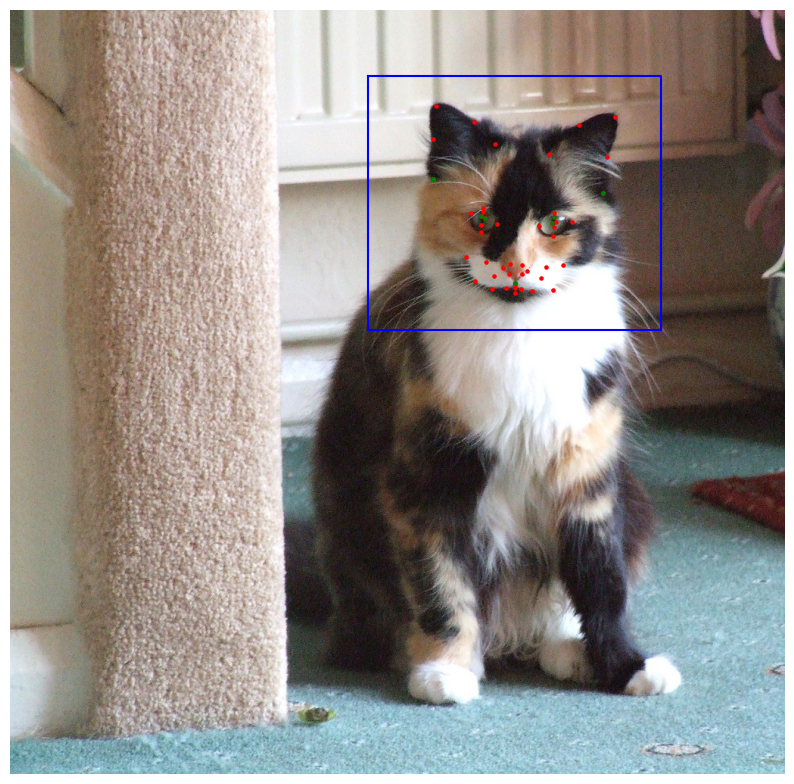

In [9]:
# Display the image with corresponding bounding box and landmark coordinates
import matplotlib.pyplot as plt

# Choose a random image
idx = np.random.randint(0, len(images))

# Get the image, landmarks, and bounding box
image = images[idx]
#temp_landmarks = labels[idx]
landmarks = labels[idx]
bbox = bboxes[idx]

# Create a figure and plot the image
plt.figure(figsize=(10, 10))
plt.imshow(image)

# Plot the landmarks
plt.scatter(landmarks[:, 0], landmarks[:, 1], s=5, c='red')
plt.scatter(landmarks[[36,37,39,40,22,31,16], 0], landmarks[[36,37,39,40,22,31,16], 1], s=5, c='green')

# Plot the bounding box
plt.plot([bbox[0], bbox[0], bbox[2], bbox[2], bbox[0]],
         [bbox[1], bbox[3], bbox[3], bbox[1], bbox[1]],
         c='blue')

plt.axis('off')
# Show the plot
plt.show()

# Load Data

In [35]:
# Not run
# Original data from manully curated images
'''
import pandas as pd

# Load the CSV file
file_path = '/content/cat-facial-expression-recognition/landmark_all2.csv'
df = pd.read_csv(file_path)

# Combine landmark, vector_x, and vector_y into a single identifier
df['landmark_vector_x'] = df.apply(lambda row: f"{row['landmark']}_x", axis=1)
df['landmark_vector_y'] = df.apply(lambda row: f"{row['landmark']}_y", axis=1)

# Concatenate the two pivot tables
df_wide = df.pivot_table(index=['filename', 'class', 'image_path'],
                         columns='landmark',
                         values=['vector_x', 'vector_y'],
                         aggfunc='first')

df_wide.columns = ['{}_{}'.format(col[0], col[1]) for col in df_wide.columns.values]

# Reset the index to turn the filename back into a column
df_wide.reset_index(inplace=True)
df_wide.drop(columns=['filename'], inplace=True)
df_wide = df_wide[~df_wide['class'].str.contains('neutral', case=False, na=False)]
df_wide = df_wide.reset_index(drop=True)
# Save the transformed dataframe to a new CSV file
#output_file_path = 'path/to/vector_data_wide.csv'
#df_wide.to_csv(output_file_path, index=False)
'''

'\nimport pandas as pd\n\n# Load the CSV file\nfile_path = \'/content/cat-facial-expression-recognition/landmark_all2.csv\'\ndf = pd.read_csv(file_path)\n\n# Combine landmark, vector_x, and vector_y into a single identifier\ndf[\'landmark_vector_x\'] = df.apply(lambda row: f"{row[\'landmark\']}_x", axis=1)\ndf[\'landmark_vector_y\'] = df.apply(lambda row: f"{row[\'landmark\']}_y", axis=1)\n\n# Concatenate the two pivot tables\ndf_wide = df.pivot_table(index=[\'filename\', \'class\', \'image_path\'],\n                         columns=\'landmark\',\n                         values=[\'vector_x\', \'vector_y\'],\n                         aggfunc=\'first\')\n\ndf_wide.columns = [\'{}_{}\'.format(col[0], col[1]) for col in df_wide.columns.values]\n\n# Reset the index to turn the filename back into a column\ndf_wide.reset_index(inplace=True)\ndf_wide.drop(columns=[\'filename\'], inplace=True)\ndf_wide = df_wide[~df_wide[\'class\'].str.contains(\'neutral\', case=False, na=False)]\ndf_wide = df

In [ ]:
'''
# Standardize landmarks

from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()

columns_to_scale = df_wide.columns[2:]  # All columns except the first and second
columns_untouched = df_wide.columns[:2]  # First and second columns

# Fit and transform the data
scaled_data = scaler.fit_transform(df_wide[columns_to_scale])

df_scaled = pd.DataFrame(scaled_data, columns=columns_to_scale)

# Concatenate the untouched columns with the scaled columns
df_final = pd.concat([df_wide[columns_untouched], df_scaled], axis=1)

print(df_final)
'''

       class                                         image_path  vector_x_0  \
0        sad  /content/cat-facial-expression-recognition/Ima...   -0.301768   
1        sad  /content/cat-facial-expression-recognition/Ima...   -0.301768   
2        sad  /content/cat-facial-expression-recognition/Ima...    0.255665   
3        sad  /content/cat-facial-expression-recognition/Ima...    0.255665   
4        sad  /content/cat-facial-expression-recognition/Ima...    0.255665   
..       ...                                                ...         ...   
261    angry  /content/cat-facial-expression-recognition/Ima...    0.813097   
262      sad  /content/cat-facial-expression-recognition/Ima...   -0.301768   
263  purring  /content/cat-facial-expression-recognition/Ima...    0.255665   
264    angry  /content/cat-facial-expression-recognition/Ima...    1.370530   
265      sad  /content/cat-facial-expression-recognition/Ima...   -0.859201   

     vector_x_1  vector_x_2  vector_x_3  vector_x_4

# Data Loading and Augmentation

In [ ]:
'''
# Original data loading

import numpy as np
import pandas as pd
import tensorflow as tf
from sklearn.model_selection import train_test_split
from PIL import Image
import os

# Load landmarks and labels
landmarks_df = df_wide
image_paths = landmarks_df['image_path'].values
landmarks = landmarks_df.drop(columns=['image_path','class']).values

# Example labels (You should replace this with your actual labels)
labels = landmarks_df['class'].values

# Create label mapping
label_to_int = {label: idx for idx, label in enumerate(np.unique(labels))}
int_to_label = {idx: label for label, idx in label_to_int.items()}

# Convert string labels to integer labels
integer_labels = np.array([label_to_int[label] for label in labels])
'''

In [179]:
# CatFLW data loading

import numpy as np
import pandas as pd
import tensorflow as tf
from sklearn.model_selection import train_test_split
from PIL import Image
import os

# Load landmarks and labels
landmarks_df = vector_df
image_paths = landmarks_df['file_path'].values
landmarks = landmarks_df.drop(columns=['file_path','image_file','Class','bounding_box']).values

# Example labels (You should replace this with your actual labels)
labels = landmarks_df['Class'].values

# Create label mapping
label_to_int = {label: idx for idx, label in enumerate(np.unique(labels))}
int_to_label = {idx: label for label, idx in label_to_int.items()}

# Convert string labels to integer labels
integer_labels = np.array([label_to_int[label] for label in labels])

In [180]:
# Check Label Shape and Labels
print(labels.shape, landmarks.shape)
print(labels)

(173,) (173, 96)
['Terrified' 'Attentive' 'Attentive' 'Attentive' 'Attentive' 'Terrified'
 'Relaxed' 'Attentive' 'Relaxed' 'Relaxed' 'Attentive' 'Attentive'
 'Relaxed' 'Attentive' 'Attentive' 'Relaxed' 'Attentive' 'Attentive'
 'Relaxed' 'Terrified' 'Attentive' 'Attentive' 'Terrified' 'Relaxed'
 'Attentive' 'Terrified' 'Attentive' 'Attentive' 'Relaxed' 'Relaxed'
 'Attentive' 'Attentive' 'Attentive' 'Relaxed' 'Attentive' 'Attentive'
 'Attentive' 'Terrified' 'Attentive' 'Relaxed' 'Terrified' 'Terrified'
 'Relaxed' 'Terrified' 'Attentive' 'Attentive' 'Relaxed' 'Attentive'
 'Attentive' 'Attentive' 'Relaxed' 'Relaxed' 'Relaxed' 'Relaxed'
 'Attentive' 'Terrified' 'Terrified' 'Attentive' 'Attentive' 'Relaxed'
 'Attentive' 'Attentive' 'Attentive' 'Terrified' 'Relaxed' 'Relaxed'
 'Terrified' 'Attentive' 'Relaxed' 'Terrified' 'Terrified' 'Attentive'
 'Attentive' 'Relaxed' 'Attentive' 'Attentive' 'Attentive' 'Terrified'
 'Attentive' 'Attentive' 'Terrified' 'Attentive' 'Attentive' 'Relaxed'
 'Relax

In [181]:
# Image processing with bounding box cropping and conversion to grayscale (with backward conversion for pre-trained image model)

def load_and_preprocess_image(image_path, bounding_box, target_size=(150, 150)):
    try:
        # Open the image
        img = Image.open(image_path)

        # Crop the image using the bounding box coordinates
        x_min, y_min, x_max, y_max = bounding_box
        img = img.crop((x_min, y_min, x_max, y_max))

        # Resize the image
        img = img.resize(target_size)

        # Convert image to grayscale
        img = img.convert('L')  # 'L' mode is for grayscale

        # Convert image to numpy array and ensure it's in uint8 format
        img_array = np.array(img, dtype=np.uint8)

        # If the image is grayscale, convert it to RGB
        if len(img_array.shape) == 2 or (len(img_array.shape) == 3 and img_array.shape[2] == 1):
            img_array = cv2.cvtColor(img_array, cv2.COLOR_GRAY2RGB)

        # Normalize the image
        img_array = img_array / 255.0

        return img_array
    except Exception as e:
        print(f"Error loading image {image_path}: {e}")
        return None

# Load and preprocess images
target_size = (224, 224)
images = [load_and_preprocess_image(row['file_path'], row['bounding_box'], target_size=target_size) for _, row in filtered_df.iterrows()]

In [ ]:
'''
def load_and_preprocess_image(image_path, target_size=(150, 150)):
    try:
        # Open and resize the image
        img = Image.open(image_path)
        img = img.resize(target_size)

        # Convert image to numpy array and ensure it's in uint8 format
        img_array = np.array(img, dtype=np.uint8)

        # Convert image to grayscale
        img = img.convert('L')  # 'L' mode is for grayscale

        # If the image is grayscale, convert it to RGB
        if len(img_array.shape) == 2 or (len(img_array.shape) == 3 and img_array.shape[2] == 1):
            img_array = cv2.cvtColor(img_array, cv2.COLOR_GRAY2RGB)

        # Normalize the image
        img_array = img_array / 255.0

        filename = image_path
        return img_array
    except Exception as e:
        print(f"Error loading image {image_path}: {e}")
        return None

# Load and preprocess images
target_size = (224,224)
images = ([load_and_preprocess_image(img_path, target_size=target_size) for img_path in image_paths])
'''

In [13]:
# Check image array shapes (Should be (_ , 224, 224, 3))
np.shape(images)

(173, 224, 224, 3)

In [14]:
# Check if grayscale images are processed correctly (Should not print anything)
for img in images:
  if len(img.shape) == 2:
    print(img.shape)

In [15]:
# Train-test split with stratification
X_train_images, X_val_images, X_train_landmarks, X_val_landmarks, y_train, y_val = train_test_split(
    images, landmarks, integer_labels,
    test_size=0.3,
    random_state=22,
    stratify=integer_labels  # Ensure stratification based on labels
)

In [48]:
X_train_images[1]

array([[[0.37254902, 0.37254902, 0.37254902],
        [0.37254902, 0.37254902, 0.37254902],
        [0.37254902, 0.37254902, 0.37254902],
        ...,
        [0.2627451 , 0.2627451 , 0.2627451 ],
        [0.21568627, 0.21568627, 0.21568627],
        [0.17647059, 0.17647059, 0.17647059]],

       [[0.37254902, 0.37254902, 0.37254902],
        [0.37254902, 0.37254902, 0.37254902],
        [0.37647059, 0.37647059, 0.37647059],
        ...,
        [0.28235294, 0.28235294, 0.28235294],
        [0.23137255, 0.23137255, 0.23137255],
        [0.16862745, 0.16862745, 0.16862745]],

       [[0.37647059, 0.37647059, 0.37647059],
        [0.37647059, 0.37647059, 0.37647059],
        [0.37647059, 0.37647059, 0.37647059],
        ...,
        [0.30196078, 0.30196078, 0.30196078],
        [0.23529412, 0.23529412, 0.23529412],
        [0.18431373, 0.18431373, 0.18431373]],

       ...,

       [[0.22352941, 0.22352941, 0.22352941],
        [0.20392157, 0.20392157, 0.20392157],
        [0.18039216, 0

In [16]:
# Check number of samples for each class to confirm correct stratification

import numpy as np
from collections import Counter

# Count occurrences of each class in the training set
train_class_counts = Counter(y_train)
print("Number of samples per class in training set:")
for class_label, count in train_class_counts.items():
    print(f"Class {class_label}: {count} samples")

# Count occurrences of each class in the validation set
val_class_counts = Counter(y_val)
print("\nNumber of samples per class in validation set:")
for class_label, count in val_class_counts.items():
    print(f"Class {class_label}: {count} samples")

Number of samples per class in training set:
Class 1: 38 samples
Class 2: 24 samples
Class 0: 59 samples

Number of samples per class in validation set:
Class 0: 25 samples
Class 2: 10 samples
Class 1: 17 samples


In [17]:
# Convert labels to categorical
num_classes = len(np.unique(labels))
y_train = tf.keras.utils.to_categorical(y_train, num_classes)
y_val = tf.keras.utils.to_categorical(y_val, num_classes)

In [18]:
print(num_classes, y_val[0])

3 [1. 0. 0.]


In [19]:
# Augement images and landmarks together

import tensorflow as tf
import albumentations as A
import numpy as np
from PIL import Image

def add_noise_to_landmarks(landmarks, noise_level=1e-5):
    """
    Add Gaussian noise to landmarks.

    Args:
    - landmarks (np.ndarray): Array of shape (n_landmarks, 2) containing landmark coordinates.
    - noise_level (float): Standard deviation of Gaussian noise to be added.

    Returns:
    - np.ndarray: Landmarks with added noise.
    """
    noise = np.random.normal(scale=noise_level, size=landmarks.shape)
    noisy_landmarks = landmarks + noise
    return noisy_landmarks

def augment_image(image):
    """
    Augment the image without altering the landmarks.

    Args:
    - image (np.ndarray): The image to be augmented.

    Returns:
    - np.ndarray: Augmented image.
    """
    transform = A.Compose([
        A.HorizontalFlip(p=0.5),
        #A.RandomRotate90(p=0.5),
        A.ColorJitter(p=0.3),
        A.RandomBrightnessContrast(p=0.3),
        #A.Rotate(p=0.8)
        A.ShiftScaleRotate(shift_limit=0.1, scale_limit=0.1, rotate_limit=20, p=0.9)
    ])

    # Ensure image is in uint8 format
    image = (image * 255).astype(np.uint8)

    # Apply the transformations
    augmented = transform(image=image)
    augmented_image = augmented['image']

    return augmented_image

# Function to augment data
def augment_data(images, landmarks, augmentations_per_image=5, noise_level=1e-4):
    augmented_images = []
    augmented_landmarks = []
    for img, lnd in zip(images, landmarks):
        for _ in range(augmentations_per_image):
            aug_img = augment_image(img)
            noisy_lnd = add_noise_to_landmarks(lnd.reshape(-1, 2), noise_level).flatten()
            augmented_images.append(aug_img)
            augmented_landmarks.append(noisy_lnd)
    return np.array(augmented_images), np.array(augmented_landmarks)

# Apply augmentations to the training data
augmentations_per_image = 5  # Number of augmentations per image
augmented_X_train_images, augmented_X_train_landmarks = augment_data(X_train_images, X_train_landmarks, augmentations_per_image)

# Repeat labels to match the number of augmented images
y_train_repeated = np.repeat(y_train, augmentations_per_image, axis=0)

# Create a tf.data.Dataset
def create_dataset(images, landmarks, labels, batch_size):
    dataset = tf.data.Dataset.from_tensor_slices(((images, landmarks), labels))
    dataset = dataset.shuffle(buffer_size=len(images)).batch(batch_size).prefetch(buffer_size=tf.data.experimental.AUTOTUNE)
    return dataset

batch_size = 32

train_dataset = create_dataset(augmented_X_train_images, augmented_X_train_landmarks, y_train_repeated, batch_size)
validation_dataset = create_dataset(X_val_images, X_val_landmarks, y_val, batch_size)

In [20]:
augmented_X_train_images.shape ,y_train_repeated.shape

((605, 224, 224, 3), (605, 3))

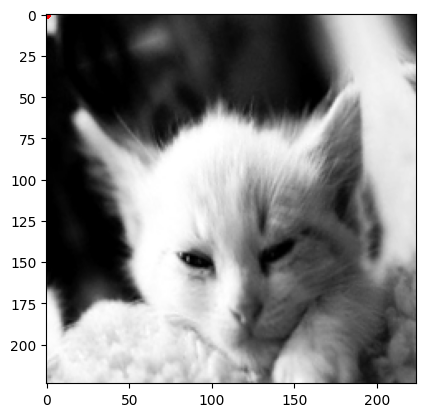

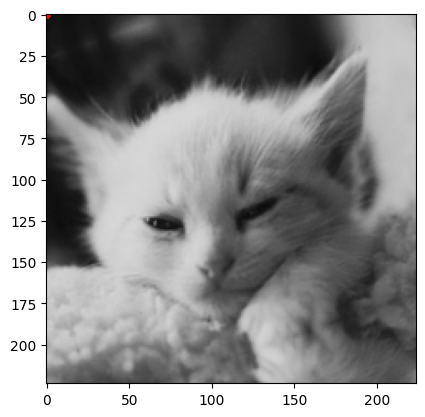

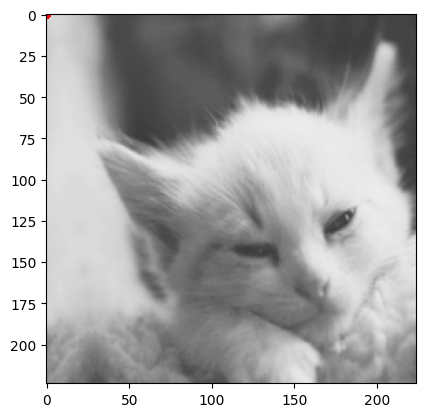

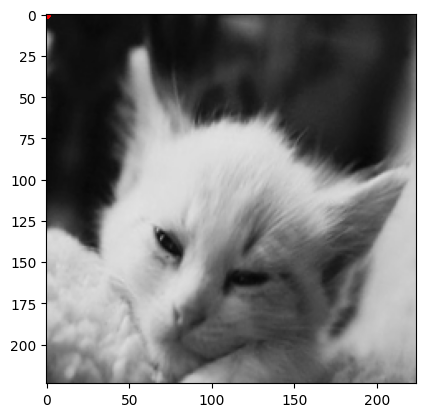

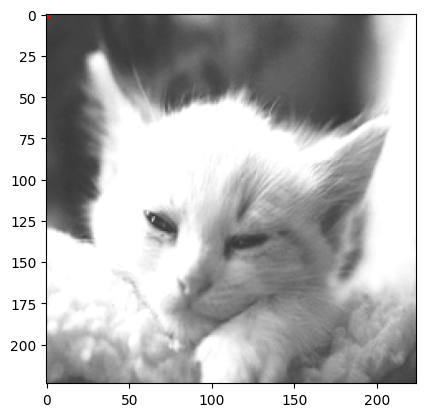

...

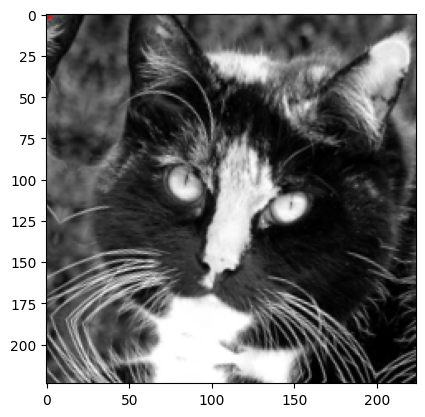

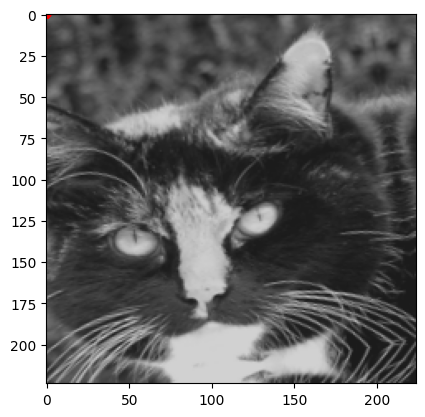

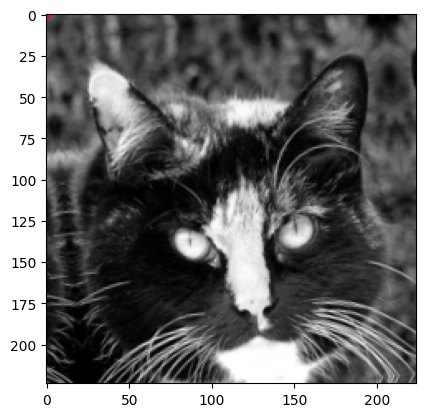

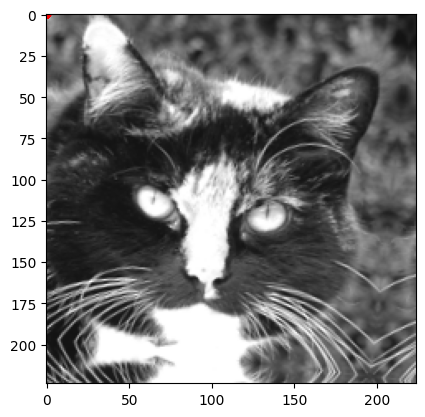

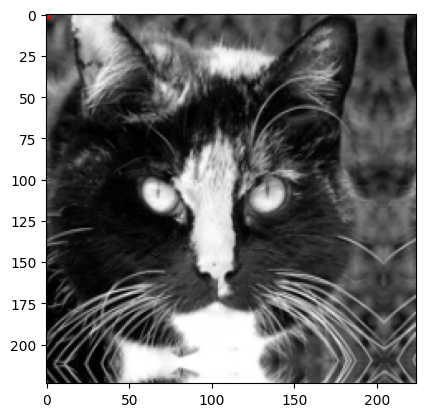

In [21]:
# Display augmented images
import matplotlib.pyplot as plt

def plot_image_with_landmarks(image, landmarks):
    """
    Plots an image with landmarks overlaid.

    Args:
    - image (np.ndarray): The image to plot.
    - landmarks (np.ndarray): Array of shape (n_landmarks, 2) containing landmark coordinates.
    """
    plt.imshow(image)
    for (x, y) in landmarks.reshape(-1, 2):
        plt.scatter(x, y, c='red', s=10)
    plt.show()

    # Display the augmented image with landmarks

for i in range(100,115):
  plot_image_with_landmarks(augmented_X_train_images[i], augmented_X_train_landmarks[i])

#Create and Train the Models

In [109]:
!wandb login 872265a615a7284a38f47af24b872eaee0dfcfa6

wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


# Landmark-Only MLP

In [198]:
learning_rate = 1e-3
num_epochs = 300

In [199]:
# This is the code to train from extracted landmarks

# Set fixed seeding values for reproducability during experiments

#np.random.seed(2233)
#tf.random.set_seed(3031)

import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, LabelEncoder
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.regularizers import l1_l2
from sklearn.preprocessing import Normalizer, LabelEncoder
from tensorflow.keras.layers import Dense, Dropout
from tensorflow.keras.regularizers import l1_l2
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix

# Build the model with L1 and L2 regularization
model_landmark_only = Sequential([
    Dense(128, activation='relu', input_shape=(X_train_landmarks.shape[1],)),  # Apply L1 and L2 regularization
    Dropout(0.5),  # Dropout layer
    Dense(128, activation='relu',
    kernel_regularizer=l1_l2(l1=0.01, l2=0.01)),  # Apply L1 and L2 regularization
    Dropout(0.5),  # Dropout layer
    Dense(128, activation='relu'),
    Dense(num_classes, activation='softmax')
])

# Compile the model
model_landmark_only.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=learning_rate),
                            loss='categorical_crossentropy',
                            metrics=['accuracy'])

In [200]:
import wandb

# Initialize Wandb
run = wandb.init(
    # set the wandb project where this run will be logged
    project="Cat Facial Expression Recognition",

    # track hyperparameters and run metadata
    config={
    "learning_rate": learning_rate,
    "model": "Landmark",
    "architecture": "MLP",
    "dataset": "CatFLW",
    "epochs": num_epochs,
    }
)

In [201]:
from wandb.integration.keras import WandbMetricsLogger

# Train the model and save the history
#history_landmark_only = model_landmark_only.fit(X_train_landmarks, y_train, epochs=300, batch_size=32, validation_split=0.3,)
history_landmark_only = model_landmark_only.fit(x = augmented_X_train_landmarks,
                                                y = y_train_repeated,
                                                epochs=num_epochs,
                                                validation_data=(X_val_landmarks,y_val),
                                                batch_size=32,
                                                #validation_split=0.2,
                                                callbacks=[WandbMetricsLogger()]
                                                )
run.finish()

Epoch 1/300
19/19 ━━━━━━━━━━━━━━━━━━━━ 6s 72ms/step - accuracy: 0.4762 - loss: 14.0208 - val_accuracy: 0.5000 - val_loss: 11.5530
Epoch 2/300
19/19 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - accuracy: 0.4894 - loss: 10.8360 - val_accuracy: 0.5385 - val_loss: 8.7630
Epoch 3/300
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 0.5136 - loss: 8.1784 - val_accuracy: 0.5385 - val_loss: 6.4547
Epoch 4/300
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - accuracy: 0.5043 - loss: 5.9827 - val_accuracy: 0.5385 - val_loss: 4.6142
Epoch 5/300
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - accuracy: 0.5374 - loss: 4.2362 - val_accuracy: 0.5385 - val_loss: 3.1828
Epoch 6/300
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.5207 - loss: 2.9441 - val_accuracy: 0.5385 - val_loss: 2.1452
Epoch 7/300
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 0.5672 - loss: 1.9617 - val_accuracy: 0.5385 - val_loss: 1.4876
Epoch 8/300
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - accuracy: 0.5732 - loss: 1.3911 - val_accuracy: 0.6

epoch/accuracy,▁▁▃▅▇▇██████████████████████████████████
epoch/epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇███
epoch/loss,█▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch/val_accuracy,▁▃▃▆▇▇▇█▇▇██▇█▇██▇█▇██▇▇█▇▇▇██▇█████▇███
epoch/val_loss,█▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch/accuracy,0.99339
epoch/epoch,299
epoch/loss,0.10892
epoch/val_accuracy,0.96154
epoch/val_loss,0.23634


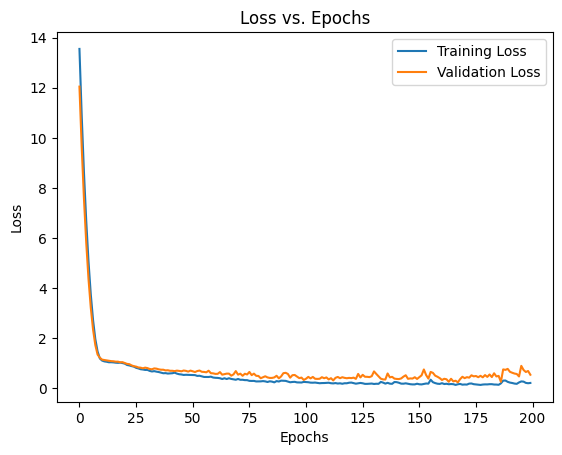

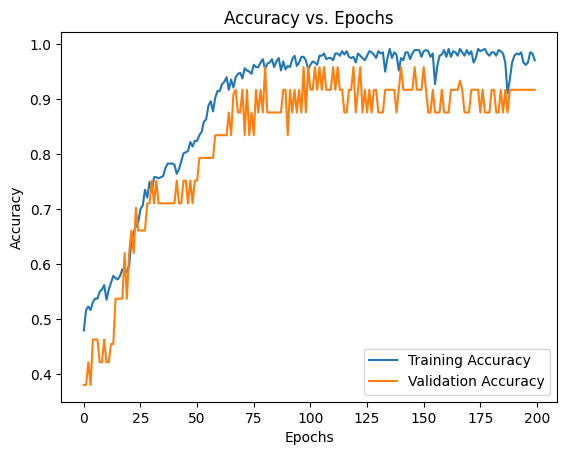

In [113]:
# Plotting the training and validation loss
plt.plot(history_landmark_only.history['loss'], label='Training Loss')
plt.plot(history_landmark_only.history['val_loss'], label='Validation Loss')
plt.title('Loss vs. Epochs')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

# Plotting the training and validation accuracy
plt.plot(history_landmark_only.history['accuracy'], label='Training Accuracy')
plt.plot(history_landmark_only.history['val_accuracy'], label='Validation Accuracy')
plt.title('Accuracy vs. Epochs')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
              precision    recall  f1-score   support

           0       0.89      0.96      0.92        25
           1       0.94      0.88      0.91        17
           2       1.00      0.90      0.95        10

    accuracy                           0.92        52
   macro avg       0.94      0.91      0.93        52
weighted avg       0.93      0.92      0.92        52



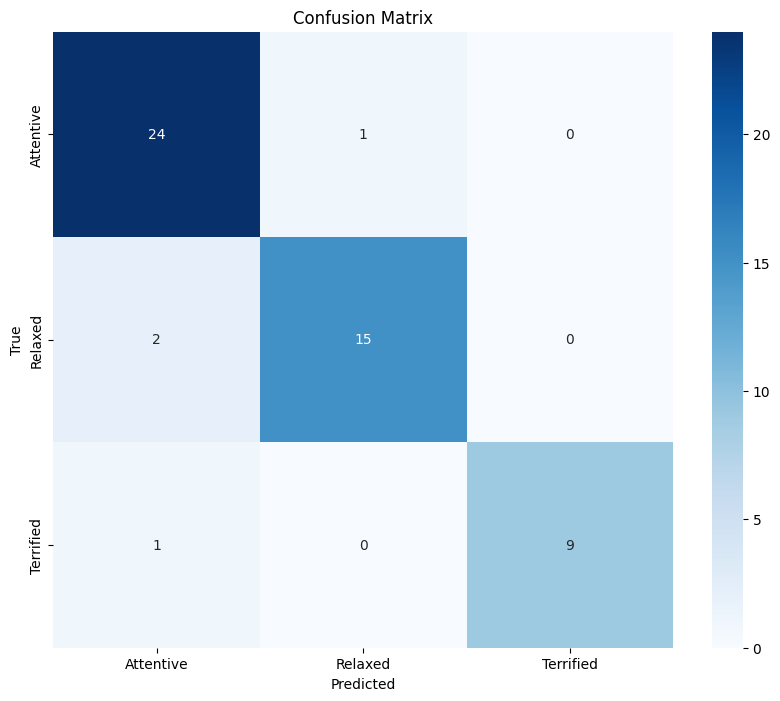

In [114]:
# Classification Report and Confusion Matrix

import numpy as np
import tensorflow as tf
from sklearn.metrics import confusion_matrix, classification_report
import matplotlib.pyplot as plt
import seaborn as sns

# Make predictions on the validation dataset
val_predictions = model_landmark_only.predict(X_val_landmarks)

# Convert predictions and true labels to class labels
val_predictions_classes = np.argmax(val_predictions, axis=1)
val_true_classes = np.argmax(y_val, axis=1)

# Generate the confusion matrix
conf_matrix = confusion_matrix(val_true_classes, val_predictions_classes)

# Print classification report
print(classification_report(val_true_classes, val_predictions_classes))


# Create a dictionary mapping class names to integer labels
unique_integers = set(integer_labels)
labels_from_int = np.array([int_to_label[integer] for integer in unique_integers])
class_names = dict(zip(labels_from_int, unique_integers))

# Visualize the confusion matrix using a heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()

Epoch 1/200


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


6/6 ━━━━━━━━━━━━━━━━━━━━ 4s 330ms/step - accuracy: 0.3574 - loss: 4.5740 - val_accuracy: 0.2917 - val_loss: 4.1841
Epoch 2/200
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.3850 - loss: 4.3937 - val_accuracy: 0.3333 - val_loss: 4.0633
Epoch 3/200
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.4025 - loss: 4.1682 - val_accuracy: 0.2917 - val_loss: 3.9445
Epoch 4/200
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.3896 - loss: 4.0398 - val_accuracy: 0.2917 - val_loss: 3.8465
Epoch 5/200
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.3676 - loss: 3.9608 - val_accuracy: 0.2917 - val_loss: 3.7559
Epoch 6/200
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.4237 - loss: 3.8907 - val_accuracy: 0.3125 - val_loss: 3.6717
Epoch 7/200
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.4318 - loss: 3.8543 - val_accuracy: 0.3125 - val_loss: 3.6054
Epoch 8/200
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.4519 - loss: 3.6546 - val_accuracy: 0.3333 - val_loss: 3.5343
Epoch 9/20

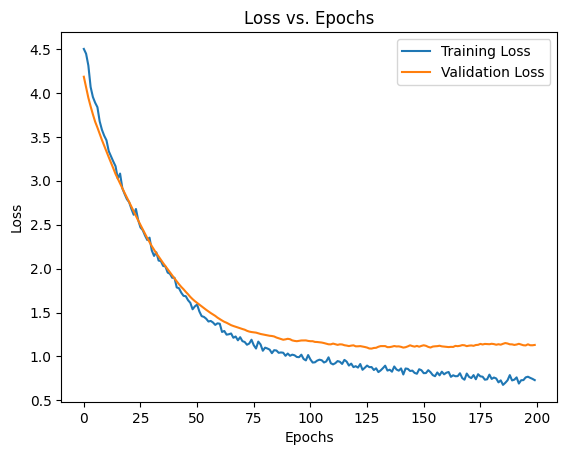

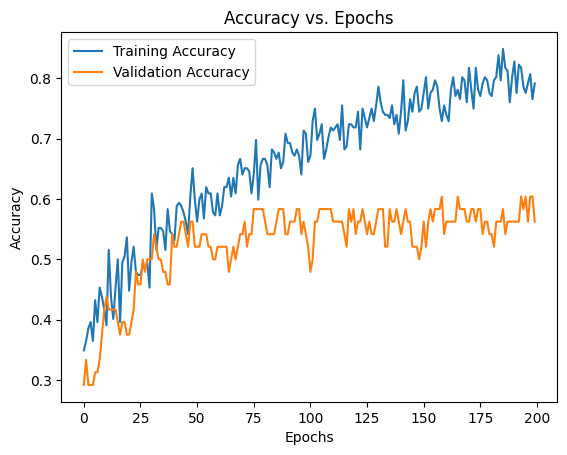

In [ ]:
'''
# Original code from Boss

import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, LabelEncoder
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.regularizers import l1_l2
from sklearn.preprocessing import Normalizer, LabelEncoder
from tensorflow.keras.layers import Dense, Dropout
from tensorflow.keras.regularizers import l1_l2
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix

#data = pd.read_csv('Cat_database_3class.csv')
# Separate features and target
X = df_final.drop(columns=['class', 'image_path'])
y = df_final['class']

# Encode the target labels
label_encoder = LabelEncoder()
y_encoded = label_encoder.fit_transform(y)

# One-hot encode the target
y_categorical = to_categorical(y_encoded)

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y_categorical, test_size=0.2, random_state=42
                                                    #,stratify=y_categorical
                                                    )

# Standardize the feature data
#scaler = StandardScaler()
#X_train = scaler.fit_transform(X_train)
#X_test = scaler.transform(X_test)

# Build the model with L1 and L2 regularization
model = Sequential([
    Dense(64, activation='relu', input_shape=(X_train.shape[1],)),  # Apply L1 and L2 regularization
    Dropout(0.5),  # Dropout layer
    Dense(32, activation='relu',
    kernel_regularizer=l1_l2(l1=0.01, l2=0.01)),  # Apply L1 and L2 regularization
    Dropout(0.5),  # Dropout layer
    Dense(y_categorical.shape[1], activation='softmax')
])

# Compile the model
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Train the model and save the history
history = model.fit(X_train, y_train, epochs=200, batch_size=32, validation_split=0.2)

# Evaluate the model
loss, accuracy = model.evaluate(X_test, y_test)
print(f'Loss: {loss}, Accuracy: {accuracy}')

# Plotting the training and validation loss
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Loss vs. Epochs')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

# Plotting the training and validation accuracy
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Accuracy vs. Epochs')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()
'''

# Image-Only Model

In [146]:
# Choose Base Model and other parameters

from tensorflow.keras.layers import Input
from tensorflow.keras.losses import CategoricalFocalCrossentropy, CategoricalCrossentropy, binary_crossentropy

image_input = Input(shape=(224, 224, 3))
base_model = tf.keras.applications.ResNet50V2(weights='imagenet', include_top=False, input_tensor=image_input)
num_epochs = 3
learning_rate = 1e-2
selected_loss = tf.keras.losses.CategoricalCrossentropy()

In [147]:
# Set up model using base pre-trained model

from tensorflow.keras import layers, models
import tensorflow as tf
from tensorflow.keras.layers import Input, Dense, Flatten, concatenate, GlobalAveragePooling2D, Dropout, BatchNormalization, MaxPooling2D
from tensorflow.keras.models import Model
from tensorflow.keras.applications import ResNet50V2
from tensorflow.keras.optimizers import Adam

# Add custom layers
# num_custom_classes = 3
x = base_model.output
#x = MaxPooling2D((1, 1))(x)
x = Flatten()(x)
x = Dense(256, activation='relu')(x)
x = Dropout(0.5)(x)
x = Dense(128, activation='relu')(x)
x = Dropout(0.3)(x)
x = Dense(num_classes, activation='softmax')(x)  # Replace with your number of classes

# Create the model
image_model = Model(inputs=[image_input], outputs=x)

# If trainable is True, we can set train the layers after last_layer_to_freeze
freeze_model = True
last_layer_to_freeze = 426

if freeze_model == True:
  base_model.trainable = False

elif freeze_model == True:
  for layer in base_model.layers[:last_layer_to_freeze]:
    layer.trainable = False
  for layer in base_model.layers[last_layer_to_freeze:]:
    layer.trainable = True

# Compile the model
image_model.compile(
                      optimizer=tf.keras.optimizers.Adam(learning_rate=learning_rate),
                      loss='categorical_crossentropy',
                      metrics=['accuracy']
                      )

# Callback to save models and weights
save_weights_only = False
save_dir = '/content/cat-facial-image-recognition/saved_model/'

if save_weights_only:
  checkpoint_filepath = save_dir + base_model.name + "bestmodel_epoch{epoch:03d}_valloss{val_loss:.2f}.weights.h5"
else:
  checkpoint_filepath = save_dir + base_model.name + "bestmodel_epoch{epoch:03d}_valloss{val_loss:.2f}.keras"
model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint( filepath=checkpoint_filepath,
                                                                save_weights_only=save_weights_only,
                                                                monitor='val_loss',
                                                                mode='min',
                                                                verbose = 1,
                                                                save_best_only=True )

In [148]:
# Section to create image-only dataset for comparison
def create_image_only_dataset(images, labels, batch_size):
    dataset = tf.data.Dataset.from_tensor_slices((images, labels))
    dataset = dataset.shuffle(buffer_size=len(images)).batch(batch_size).prefetch(buffer_size=tf.data.experimental.AUTOTUNE)
    return dataset

# Augment the images without altering landmarks for image-only dataset
augmented_X_train_images_only = []
for img in X_train_images:
    for _ in range(augmentations_per_image):
        aug_img = augment_image(img)
        augmented_X_train_images_only.append(aug_img)
augmented_X_train_images_only = np.array(augmented_X_train_images_only)

# Repeat labels to match the number of augmented images for image-only dataset
y_train_repeated_images_only = np.repeat(y_train, augmentations_per_image, axis=0)

# Create image-only dataset
image_only_train_dataset = create_image_only_dataset(augmented_X_train_images_only, y_train_repeated_images_only, batch_size)
image_only_validation_dataset = create_image_only_dataset(X_val_images, y_val, batch_size)

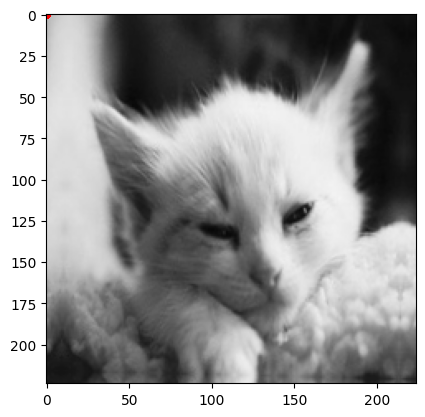

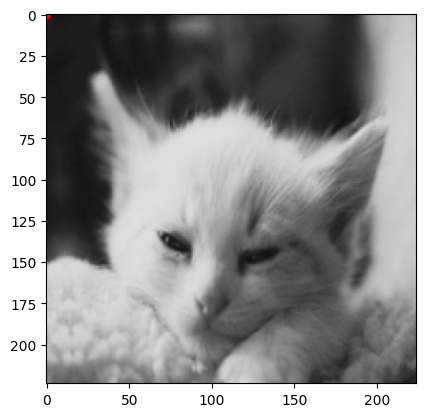

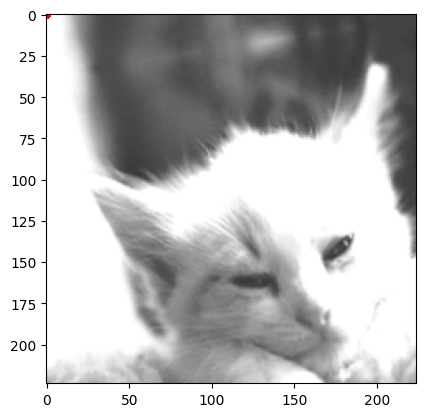

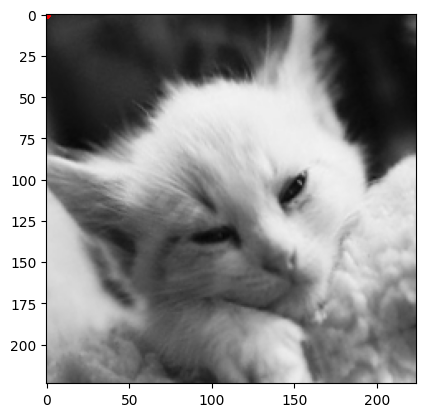

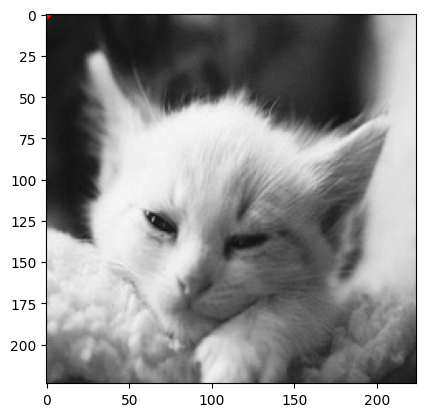

...

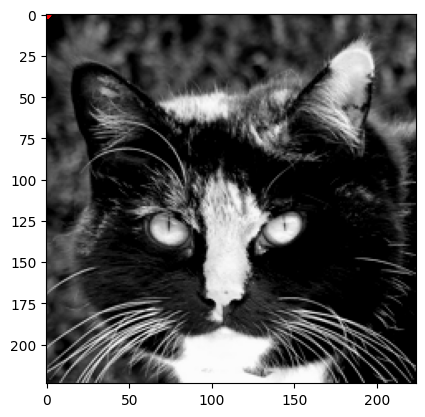

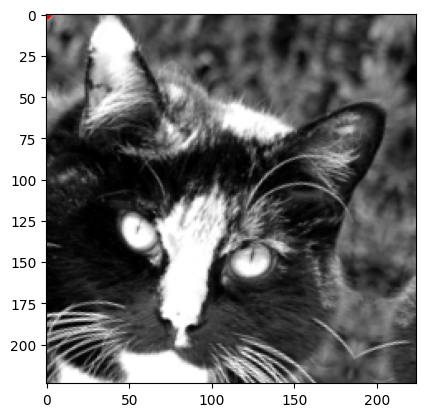

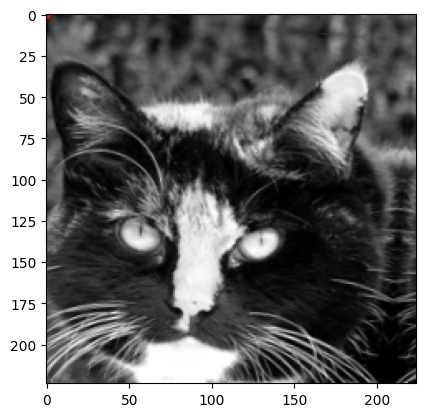

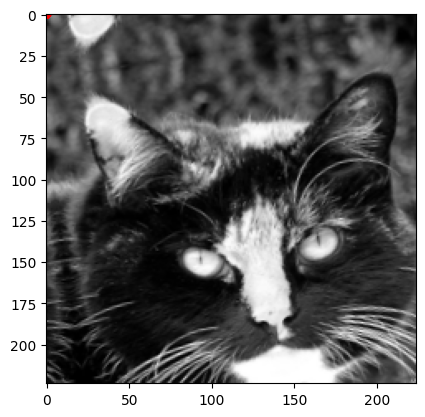

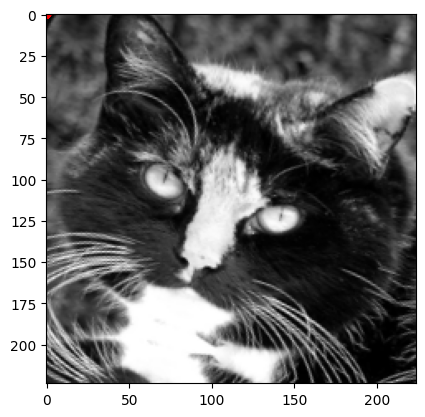

In [25]:
# Display augmented images
import matplotlib.pyplot as plt

def plot_image_with_landmarks(image, landmarks):
    """
    Plots an image with landmarks overlaid.

    Args:
    - image (np.ndarray): The image to plot.
    - landmarks (np.ndarray): Array of shape (n_landmarks, 2) containing landmark coordinates.
    """
    plt.imshow(image)
    for (x, y) in landmarks.reshape(-1, 2):
        plt.scatter(x, y, c='red', s=10)
    plt.show()

    # Display the augmented image with landmarks

for i in range(100,115):
  plot_image_with_landmarks(augmented_X_train_images_only[i], augmented_X_train_landmarks[i])

In [26]:
augmented_X_train_images_only.shape, y_train_repeated_images_only.shape, y_val.shape, num_classes

((605, 224, 224, 3), (605, 3), (52, 3), 3)

In [149]:
import wandb

# Initialize Wandb
run = wandb.init(
    # set the wandb project where this run will be logged
    project="Cat Facial Expression Recognition",

    # track hyperparameters and run metadata
    config={
    "learning_rate": learning_rate,
    "model": "Images",
    "architecture": base_model.name,
    "dataset": "CatFLW",
    "epochs": num_epochs,
    }
)

In [150]:
history_image_only = image_model.fit(
    image_only_train_dataset,
    #steps_per_epoch=train_dataset.samples // train_dataset.batch_size,
    validation_data=image_only_validation_dataset,
    #validation_steps=validation_dataset.samples // validation_dataset.batch_size,
    epochs=num_epochs,
    callbacks=[WandbMetricsLogger()]
)
run.finish()

Epoch 1/3
19/19 ━━━━━━━━━━━━━━━━━━━━ 208s 10s/step - accuracy: 0.3353 - loss: 19745.2793 - val_accuracy: 0.2308 - val_loss: 2.0895
Epoch 2/3
19/19 ━━━━━━━━━━━━━━━━━━━━ 129s 7s/step - accuracy: 0.3846 - loss: 916.4447 - val_accuracy: 0.5000 - val_loss: 1.3187
Epoch 3/3
19/19 ━━━━━━━━━━━━━━━━━━━━ 137s 7s/step - accuracy: 0.3976 - loss: 149.2174 - val_accuracy: 0.4808 - val_loss: 1.0638


In [ ]:
# Summarize history for loss
plt.figure(figsize=(15,5))
plt.plot(history_image_only.history['loss'])
plt.plot(history_image_only.history['val_loss'])
plt.title('Train loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.grid()
plt.show()

# Summarize history for accuracy
plt.figure(figsize=(15,5))
plt.plot(history_image_only.history['accuracy'])
plt.plot(history_image_only.history['val_accuracy'])
plt.title('Train accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.grid()
plt.show()

2/2 ━━━━━━━━━━━━━━━━━━━━ 10s 3s/step
              precision    recall  f1-score   support

           0       1.00      0.08      0.15        25
           1       0.42      1.00      0.60        17

    accuracy                           0.45        42
   macro avg       0.71      0.54      0.37        42
weighted avg       0.77      0.45      0.33        42



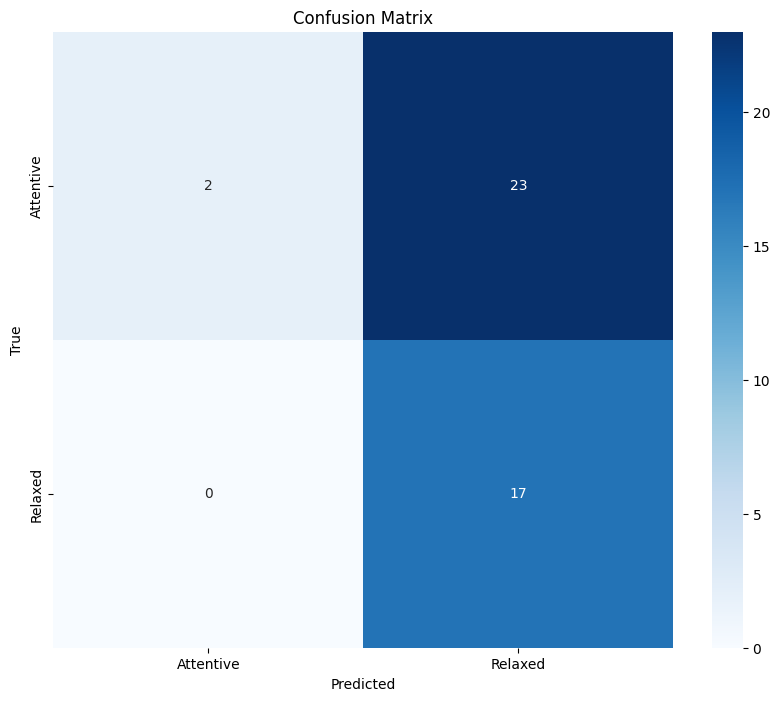

In [ ]:
# Classification Report and Confusion Matrix

import numpy as np
import tensorflow as tf
from sklearn.metrics import confusion_matrix, classification_report
import matplotlib.pyplot as plt
import seaborn as sns

# Make predictions on the validation dataset
val_predictions = image_model.predict(image_only_validation_dataset)

# Convert predictions and true labels to class labels
val_predictions_classes = np.argmax(val_predictions, axis=1)
val_true_classes = np.argmax(y_val, axis=1)

# Generate the confusion matrix
conf_matrix = confusion_matrix(val_true_classes, val_predictions_classes)

# Print classification report
print(classification_report(val_true_classes, val_predictions_classes))

# Create a dictionary mapping class names to integer labels
unique_integers = set(integer_labels)
labels_from_int = np.array([int_to_label[integer] for integer in unique_integers])
class_names = dict(zip(labels_from_int, unique_integers))

# Visualize the confusion matrix using a heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()

# Multimodal Model

In [151]:
from tensorflow.keras import layers, models
import tensorflow as tf
from tensorflow.keras.layers import Input, Dense, Flatten, concatenate, GlobalAveragePooling2D, Dropout, BatchNormalization
from tensorflow.keras.models import Model
from tensorflow.keras.applications import ResNet50V2
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.regularizers import l1_l2

# Add custom layers
# num_custom_classes = 3

x = base_model.output
x = Flatten()(x)
x = BatchNormalization()(x)
x = Dense(256, activation='relu')(x)
x = Dropout(0.5)(x)
x = Dense(256, activation='relu')(x)
x = BatchNormalization()(x)
x = Dropout(0.5)(x)

# Vector input branch
landmark_input = Input(shape=(X_train_landmarks.shape[1],))
y = Dense(128, activation='relu')(landmark_input)
# y = BatchNormalization()(y)
y = Dropout(0.5)(y)
y = Dense(128, activation='relu')(y)

# Concatenate image and vector branches
combined = concatenate([x, y])

# Additional Dense layers after concatenation
z = Dense(256, activation='relu')(combined)
z = BatchNormalization()(z)
z = Dropout(0.5)(z)
z = Dense(128, activation='relu')(z)
z = BatchNormalization()(z)
z = Dropout(0.5)(z)
z = Dense(num_classes, activation='softmax')(z)

# Original custom model
'''x = base_model.output
x = Flatten()(x)
x = BatchNormalization()(x)  # Normalize output of base model

# Landmark input branch
landmark_input = Input(shape=(X_train_landmarks.shape[1],))
y = Dense(128, activation='relu')(landmark_input)
y = Dropout(0.5)(y)
y = Dense(128, activation='relu',
    kernel_regularizer=l1_l2(l1=0.01, l2=0.01))(y)
y = Dropout(0.5)(y)
y = Dense(128, activation='relu')(y)

# Combine the outputs from the two branches
combined = concatenate([x, y])

# Add a few more layers
z = Dense(256, activation='relu')(combined)
z = Dropout(0.5)(z)
# z = Dense(64, activation='relu')(z)  # Apply L1 and L2 regularization
# z = Dense(32, activation='relu', kernel_regularizer=l1_l2(l1=0.01, l2=0.01))(z)
# z = Dropout(0.5)(z)
z = Dense(num_classes, activation='softmax')(z)'''

# Create the model
current_model = Model(inputs=[image_input, landmark_input], outputs=z)

# If trainable is True, we can set train the layers after last_layer_to_freeze
freeze_model = True
last_layer_to_freeze = 426

if freeze_model == True:
  base_model.trainable = False

elif freeze_model == True:
  for layer in base_model.layers[:last_layer_to_freeze]:
    layer.trainable = False
  for layer in base_model.layers[last_layer_to_freeze:]:
    layer.trainable = True

# Compile the model
current_model.compile(
                      optimizer=tf.keras.optimizers.Adam(learning_rate=learning_rate),
                      loss=selected_loss,
                      metrics=['accuracy']
                      )

# Callback to save models and weights
save_weights_only = False
save_dir = '/content/cat-facial-image-recognition/saved_model/'

if save_weights_only:
  checkpoint_filepath = save_dir + base_model.name + "bestmodel_epoch{epoch:03d}_valloss{val_loss:.2f}.weights.h5"
else:
  checkpoint_filepath = save_dir + base_model.name + "bestmodel_epoch{epoch:03d}_valloss{val_loss:.2f}.keras"
model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint( filepath=checkpoint_filepath,
                                                                save_weights_only=save_weights_only,
                                                                monitor='val_loss',
                                                                mode='min',
                                                                verbose = 1,
                                                                save_best_only=True )

In [152]:
import wandb

# Initialize Wandb
run = wandb.init(
    # set the wandb project where this run will be logged
    project="Cat Facial Expression Recognition",

    # track hyperparameters and run metadata
    config={
    "learning_rate": learning_rate,
    "model": "Images and Landmarks",
    "architecture": base_model.name,
    "dataset": "CatFLW",
    "epochs": num_epochs,
    }
)

epoch/accuracy,▁▃█
epoch/epoch,▁▅█
epoch/loss,█▁▁
epoch/val_accuracy,▁█▇
epoch/val_loss,█▃▁
epoch/accuracy,0.43802
epoch/epoch,2
epoch/loss,109.20573
epoch/val_accuracy,0.48077
epoch/val_loss,1.06381


In [153]:
from wandb.integration.keras import WandbMetricsLogger

history = current_model.fit(
    train_dataset,
    #steps_per_epoch=train_dataset.samples // train_dataset.batch_size,
    validation_data=validation_dataset,
    #validation_steps=validation_dataset.samples // validation_dataset.batch_size,
    epochs=num_epochs,
    # callbacks=[clr]
    callbacks=[WandbMetricsLogger()]
)

Epoch 1/3
19/19 ━━━━━━━━━━━━━━━━━━━━ 172s 7s/step - accuracy: 0.3618 - loss: 1.9724 - val_accuracy: 0.3269 - val_loss: 6.3268
Epoch 2/3
19/19 ━━━━━━━━━━━━━━━━━━━━ 151s 8s/step - accuracy: 0.4281 - loss: 1.2920 - val_accuracy: 0.5962 - val_loss: 0.9701
Epoch 3/3
19/19 ━━━━━━━━━━━━━━━━━━━━ 183s 7s/step - accuracy: 0.4886 - loss: 1.1185 - val_accuracy: 0.5385 - val_loss: 2.4780


6/6 ━━━━━━━━━━━━━━━━━━━━ 16s 2s/step
              precision    recall  f1-score   support

           0       0.51      1.00      0.68        47
           1       0.00      0.00      0.00         4
           2       1.00      0.03      0.06        31
           3       0.00      0.00      0.00         5
           4       0.00      0.00      0.00         6

    accuracy                           0.52        93
   macro avg       0.30      0.21      0.15        93
weighted avg       0.59      0.52      0.36        93



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


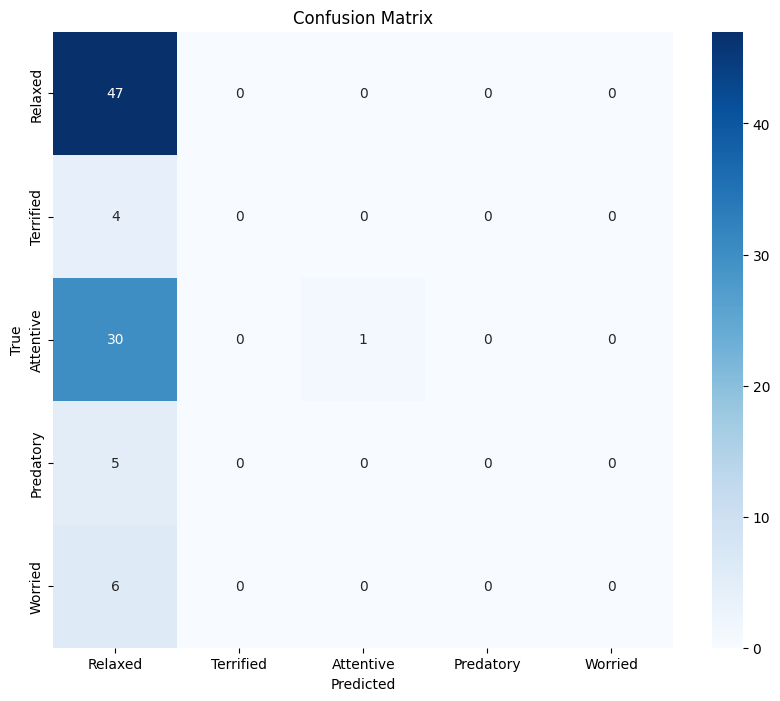

In [ ]:
import numpy as np
import tensorflow as tf
from sklearn.metrics import confusion_matrix, classification_report
import matplotlib.pyplot as plt
import seaborn as sns

# Make predictions on the validation dataset
val_predictions = current_model.predict(validation_dataset)

# Convert predictions and true labels to class labels
val_predictions_classes = np.argmax(val_predictions, axis=1)
val_true_classes = np.argmax(y_val, axis=1)

# Generate the confusion matrix
conf_matrix = confusion_matrix(val_true_classes, val_predictions_classes)

# Print classification report
print(classification_report(val_true_classes, val_predictions_classes))


# Create a dictionary mapping class names to integer labels
unique_integers = set(integer_labels)
labels_from_int = np.array([int_to_label[integer] for integer in unique_integers])
class_names = dict(zip(labels_from_int, unique_integers))


# Visualize the confusion matrix using a heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()

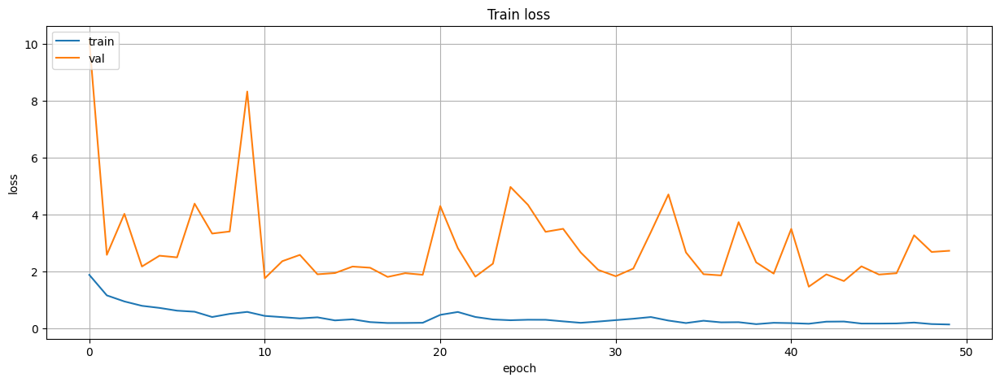

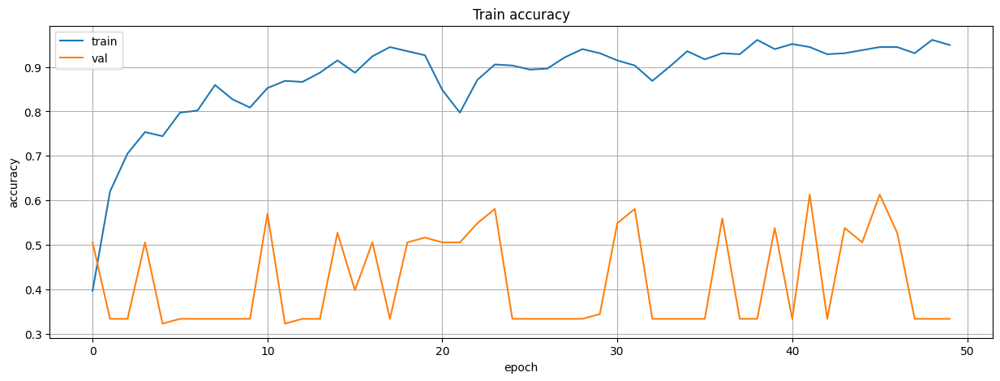

In [ ]:
# Summarize history for loss
plt.figure(figsize=(15,5))
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Train loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.grid()
plt.show()

# Summarize history for accuracy
plt.figure(figsize=(15,5))
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Train accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.grid()
plt.show()

In [ ]:
# Check Model Structure

current_model.summary()
tf.keras.utils.plot_model(current_model,
                          #to_file='cnn1_nonsequential1.png',
                          show_shapes=True, show_dtype=False, show_layer_names=True, dpi=96)

Model: "functional_11"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)  │ (None, 224, 224, 3)    │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_pad (ZeroPadding2D) │ (None, 230, 230, 3)    │              0 │ input_layer[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_conv (Conv2D)       │ (None, 112, 112, 64)   │          9,472 │ conv1_pad[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pool1_pad (ZeroPadding2D) │ (None, 114, 114, 64)   │              0 │ conv1_conv[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pool1_pool (MaxPooling2D) │ (None, 56, 56, 64)     │              0 │ pool1_pad[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_preact_bn    │ (None, 56, 56, 64)     │            256 │ pool1_pool[0][0]       │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_preact_relu  │ (None, 56, 56, 64)     │              0 │ conv2_block1_preact_b… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_conv       │ (None, 56, 56, 64)     │          4,096 │ conv2_block1_preact_r… │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_bn         │ (None, 56, 56, 64)     │            256 │ conv2_block1_1_conv[0… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_relu       │ (None, 56, 56, 64)     │              0 │ conv2_block1_1_bn[0][… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_pad        │ (None, 58, 58, 64)     │              0 │ conv2_block1_1_relu[0… │
│ (ZeroPadding2D)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_conv       │ (None, 56, 56, 64)     │         36,864 │ conv2_block1_2_pad[0]… │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_bn         │ (None, 56, 56, 64)     │            256 │ conv2_block1_2_conv[0… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_relu       │ (None, 56, 56, 64)     │              0 │ conv2_block1_2_bn[0][… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_0_conv       │ (None, 56, 56, 256)    │         16,640 │ conv2_block1_preact_r… │
│ (Conv2D)             

 Total params: 49,819,653 (190.05 MB)

 Trainable params: 26,053,125 (99.38 MB)

 Non-trainable params: 23,766,528 (90.66 MB)

# Grad-Cam

##GradCam New

In [ ]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import cv2

# Function to compute Grad-CAM
def compute_gradcam(model, img_array, layer_name='conv5_block3_out'):
    grad_model = tf.keras.models.Model(
        [model.inputs], [model.get_layer(layer_name).output, model.output]
    )

    with tf.GradientTape() as tape:
        conv_outputs, predictions = grad_model(img_array)
        loss = predictions[:, tf.argmax(predictions[0])]

    grads = tape.gradient(loss, conv_outputs)
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))

    conv_outputs = conv_outputs[0]
    heatmap = conv_outputs @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)

    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy(), tf.argmax(predictions[0]).numpy()

# Function to display Grad-CAM
def display_gradcam(img_array, heatmap, alpha=0.4):
    img = img_array[0]
    img = tf.squeeze(img).numpy()
    img = img - np.min(img)
    img = img / np.max(img)

    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
    heatmap = np.uint8(255 * heatmap)
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)

    superimposed_img = heatmap * alpha + img
    superimposed_img = np.uint8(255 * superimposed_img)

    return superimposed_img

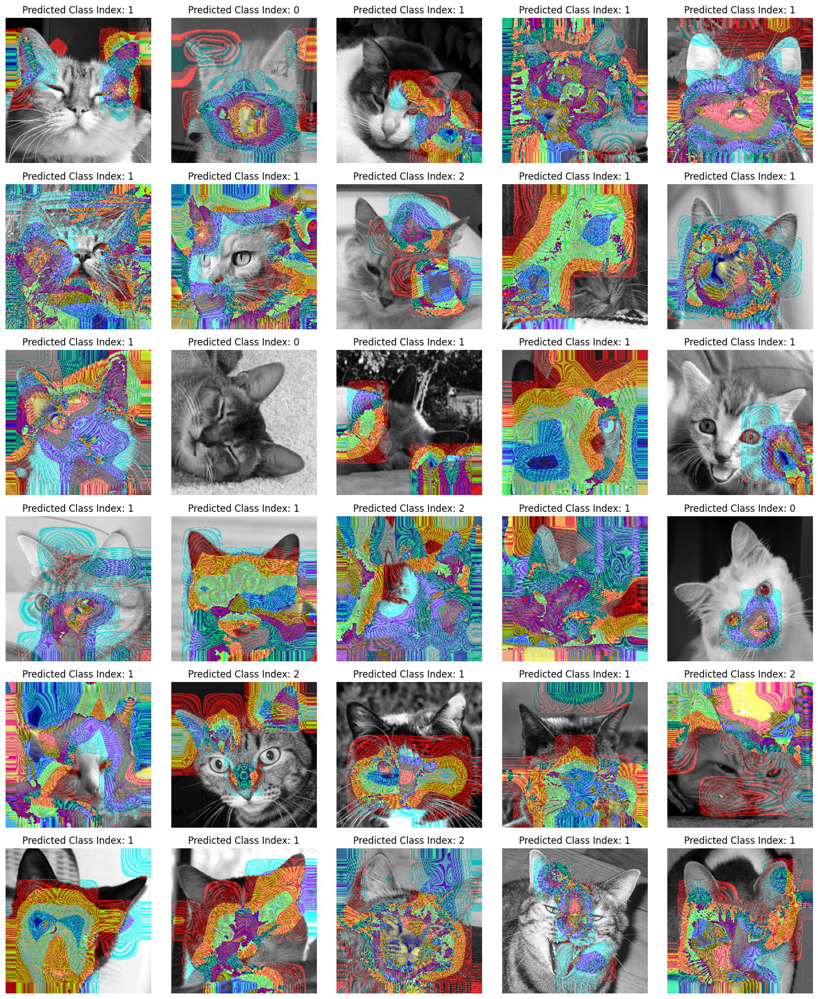

In [70]:
# Loop through images in the array
cam_images = [np.expand_dims(img, axis=0) for img in X_train_images[0:30]]

fig, axes = plt.subplots((len(cam_images) +1) // 5 , 5, figsize=(15, len(cam_images) // 5 * 3))

for i, img_array in enumerate(cam_images):
    heatmap, class_idx = compute_gradcam(image_model, img_array)
    superimposed_img = display_gradcam(img_array, heatmap)

    ax = axes[i // 5, i % 5]
    ax.imshow(superimposed_img)
    ax.set_title(f'Predicted Class Index: {class_idx}')
    ax.axis('off')

plt.tight_layout()
plt.show()

##GradCAM from HW - Not using

In [28]:
def my_imagenet_decode_predictions( preds, top=5 ):
    """
    This function is adapted from https://github.com/keras-team/keras-applications/blob/master/keras_applications/imagenet_utils.py
    The adaptation is done so that ImageNet's class indices (0-999) are included in the function's outputs.

    Arguments:
        preds (numpy array): a batch of ImageNet's prediction outputs
        top (int): only decode 'top' classes with maximum scores

    Return a tuple of:
        Output[0]: a dict of { class_index:class_name } regarding the whole ImageNet dataset
        Output[1]: a 4D tuple of (class_index, class_name, class_description, score)
            Note that 'score' can be prediction values with or without the softmax activation, depending on the input 'preds'
    """
    '''if len(preds.shape) != 2 or preds.shape[1] != 1000:
        raise ValueError('`decode_predictions` expects '
                                 'a batch of predictions '
                                 '(i.e. a 2D array of shape (samples, 1000)). '
                                 'Found array with shape: ' + str(preds.shape))'''

    import json

    CLASS_INDEX_PATH = ('https://storage.googleapis.com/download.tensorflow.org/data/imagenet_class_index.json')
    fpath = tf.keras.utils.get_file( 'imagenet_class_index.json',
                                                CLASS_INDEX_PATH,
                                                cache_subdir='models',
                                                file_hash='c2c37ea517e94d9795004a39431a14cb' )
    with open(fpath) as f:
        CLASS_INDEX = json.load(f)
        CLASS_INDEX = dict( zip( [ int(i) for i in CLASS_INDEX.keys() ], CLASS_INDEX.values() ) )

    results = []
    for pred in preds:
        top_indices = pred.argsort()[-top:][::-1]
        result = [ (i,) + tuple(CLASS_INDEX[i]) + (pred[i],) for i in top_indices ]
        result.sort(key=lambda x: x[-1], reverse=True)
        results.append(result)

    return CLASS_INDEX, results

In [29]:
def new_class_decode_predictions( preds, top=5 ):
    """
    This function is adapted from https://github.com/keras-team/keras-applications/blob/master/keras_applications/imagenet_utils.py
    The adaptation is done so that ImageNet's class indices (0-999) are included in the function's outputs.

    Arguments:
        preds (numpy array): a batch of ImageNet's prediction outputs
        top (int): only decode 'top' classes with maximum scores

    Return a tuple of:
        Output[0]: a dict of { class_index:class_name } regarding the whole ImageNet dataset
        Output[1]: a 4D tuple of (class_index, class_name, class_description, score)
            Note that 'score' can be prediction values with or without the softmax activation, depending on the input 'preds'
    """

    import json

    CLASS_INDEX = {
                   "0": ["ขาวมณี"],
                   "1": ["กวนจา"],
                   "2": ["โคราช"]
                   }

    results = []
    for pred in preds:
        top_indices = pred.argsort()[-top:][::-1]
        result = [ (i,) + tuple(CLASS_INDEX[i]) + (pred[i],) for i in top_indices ]
        result.sort(key=lambda x: x[-1], reverse=True)
        results.append(result)

    return CLASS_INDEX, results

In [30]:
def my_CNN_GradCAM( model, in_img, class_index, normalize=True ):
  '''
  A function to compute a GradCAM heatmap image

  Inputs:
    model (Keras's model): the target model that is specially prepared to be inspected by GradCAM
    in_img (NumPy array): an image to be inspected
    class_index (int, 0-999): an ImageNet's class index that we want to inspect its GradCAM heatmap
    normalize (bool): if True, normalize the resultant heatmap to [0,1]

  Outputs:
    An image of GradCAM heatmap
  '''
  # Convert from numpy to tensor
  in_img = tf.cast( in_img, tf.float32 )

  # Compute the gradient of y_c with respect to A_i
  with tf.GradientTape() as tape:
    tape.watch(in_img)
    y_linear, last_conv_activation = model( in_img )
    one_class_score = y_linear[ ..., class_index ]
  gradient = tape.gradient( one_class_score, last_conv_activation )  # tensor: shape=(1,7,7,512)

  # Compute a vector of alphas by averaging each 2D gradient
  # Note that, one alpha value refers to a single weight value for a 2D feature map
  gradient = gradient.numpy().squeeze(axis=0)    # numpy: shape=(7,7,512)
  alpha = np.mean( gradient, axis=(0,1) )   # numpy: shape=(512,)

  # Compute the weighted-sum heatmap
  last_conv_activation = last_conv_activation.numpy().squeeze(axis=0)   # numpy: shape (1,7,7,512) => (7,7,512)
  heatmap = np.dot( last_conv_activation, alpha )   # numpy: shape=(7,7)

  # Don't highlight any pixels with negative gradients (= apply ReLU)
  heatmap = np.maximum( 0, heatmap )     # numpy: shape=(7,7)

  # Return the heatmap
  return heatmap / np.max(heatmap) if normalize else heatmap

In [44]:
def visualize_GradCAM_topresult( model, original_img, input_img, logit_preds, top=100, heatmap_norm=True):
  '''
  A utility function that helps visualize the GradCAM results on top of the input image

  Inputs:
    model (Keras's model): the target model that is specially prepared to be inspected by GradCAM
    original_img (Numpy): an input image to be visualized
    input_img (Numpy): a preprocessed image to be fed to the model
    logit_preds (Numpy): an array of 1000 raw prediction scores (logits, non-softmax scores) regarding the 'input_img'
    top (int): how many class with top prediciton scores will be visualized
    heatmap_norm (bool): if True, normalize the heatmap to [0,1]
  '''
  # Get predictions with highest scores
  _ , top_results = my_imagenet_decode_predictions( logit_preds, top=top )

  # Extract 0-based class indices
  top_index = [ tp[0] for tp in top_results[0] ]

  # Visualize Grad-CAM for each class whose index is in 'top_index'
  for i,c in enumerate(top_index):
    heatmap = my_CNN_GradCAM(  model,         # the CNN model
                               input_img,     # input of the model
                               c,             # the 0-based index of the output class to compute and visualize GradCAM
                               heatmap_norm
                           )

    # Create the main figure
    fig = plt.figure(figsize=(15,5))
    class_desc = f"{imagenet_dict[c][-1]}, Top {i+1}/{top} with a logit score of {logit_preds[...,c].squeeze():.4f}"
    class_desc += f", normalized" if heatmap_norm else f", unnormalized"
    fig.suptitle( f"ImageNet class no. {c}/{len(imagenet_dict)-1} ({class_desc})" )

    # Subplot 1
    # Visualize the original heatmap
    ax = fig.add_subplot(1, 2, 1)
    ax.set_title( "Original Grad-CAM" )
    im = ax.imshow( heatmap, cmap='jet' )
    plt.colorbar( im, ax=ax )

    # Subplot 2
    # Visualize the heatmap overlaid on an input image
    ax = fig.add_subplot(1, 2, 2)
    ax.set_title( "Resized Grad-CAM on an input image" )
    ax.imshow( original_img )
    alpha = 0.6
    import cv2 as cv
    im = ax.imshow( cv.resize( heatmap, original_img.shape[:2] ), cmap='jet', alpha=alpha )
    plt.colorbar( im, ax=ax )

    # Show this figure
    plt.show()

In [45]:
'''def alter_model_for_GradCAM( model, last_conv_layer_name ):
    # 1. Get the output from the last convolutional layer
    last_conv_output = model.get_layer( last_conv_layer_name ).output

    # 2. Create the new model with one additional output
    new_model = tf.keras.Model( inputs=model.inputs, outputs=[model.output, last_conv_output] )

    return new_model'''

In [33]:
'''new_model = alter_model_for_GradCAM( current_model, 'max_pooling2d_39' )
new_model.summary()'''

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step
[[(2, 'n01484850', 'great_white_shark', 1.0), (1, 'n01443537', 'goldfish', 0.0), (0, 'n01440764', 'tench', 0.0)]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step
[[(2, 'n01484850', 'great_white_shark', 1.0), (1, 'n01443537', 'goldfish', 0.0), (0, 'n01440764', 'tench', 0.0)]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step
[[(1, 'n01443537', 'goldfish', 0.99994826), (0, 'n01440764', 'tench', 5.0448325e-05), (2, 'n01484850', 'great_white_shark', 1.3062507e-06)]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step
[[(1, 'n01443537', 'goldfish', 0.55715036), (0, 'n01440764', 'tench', 0.26377028), (2, 'n01484850', 'great_white_shark', 0.1790794)]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 189ms/step
[[(2, 'n01484850', 'great_white_shark', 0.65701354), (1, 'n01443537', 'goldfish', 0.29900813), (0, 'n01440764', 'tench', 0.04397841)]]
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step
[[(0, 'n01440764', 'tench', 0.35713512), (1, 'n01443537', 'goldfish', 0.34728122), (2, 'n01484850', 'great_white_shark', 0.29558

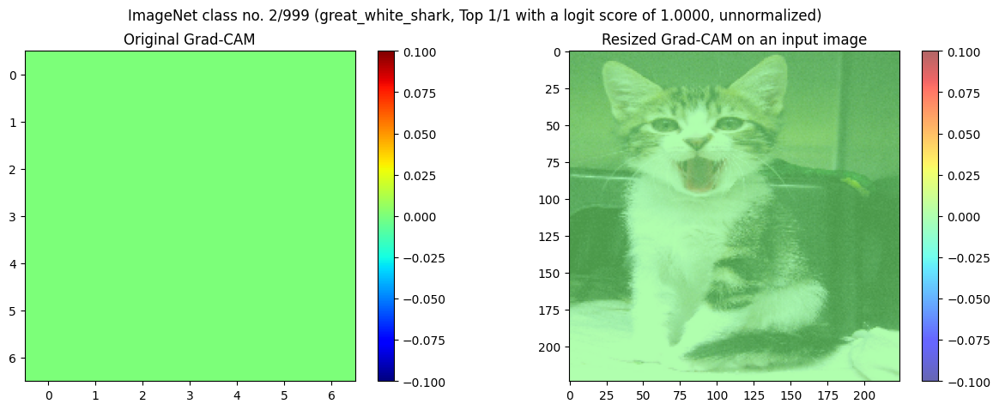

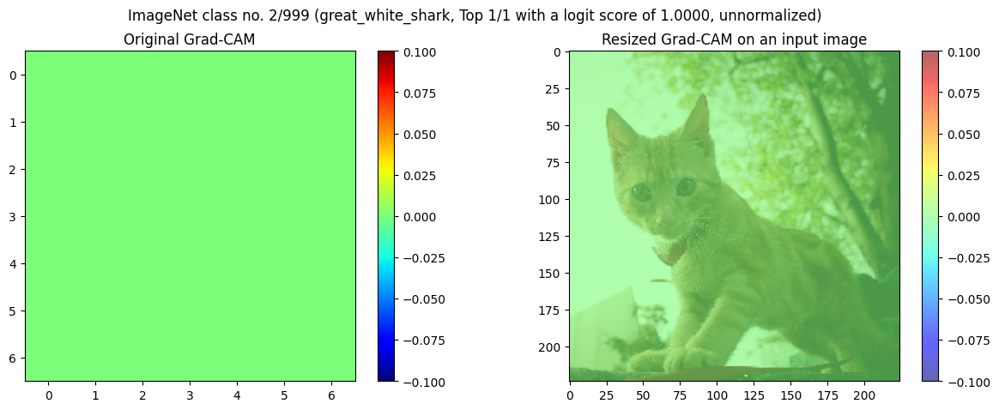

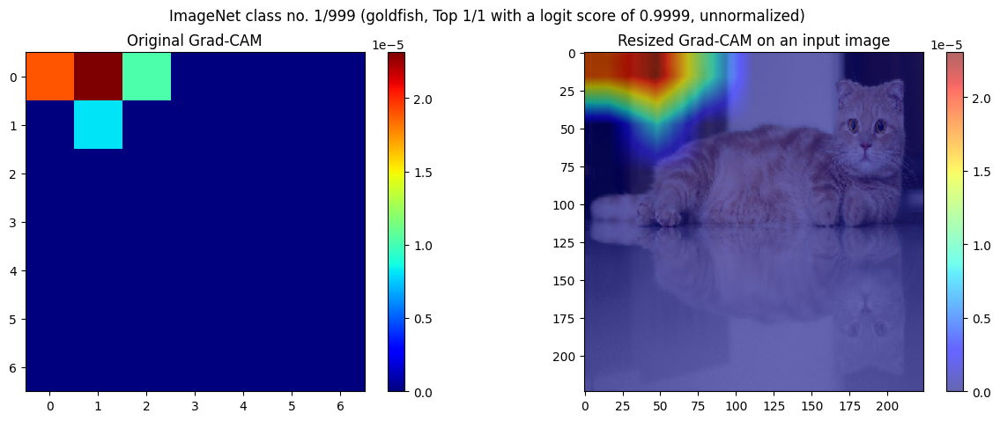

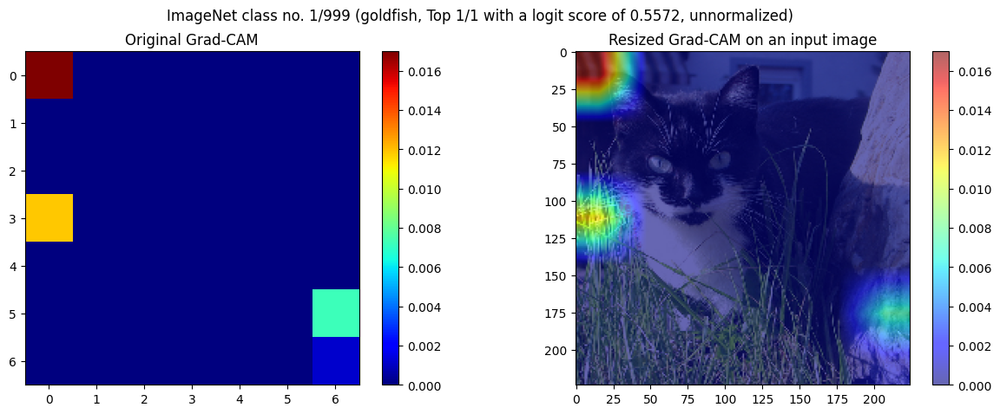

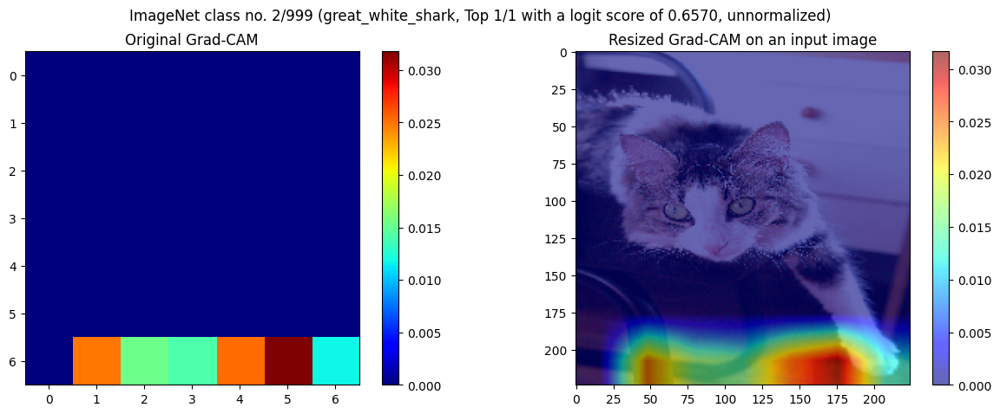

...

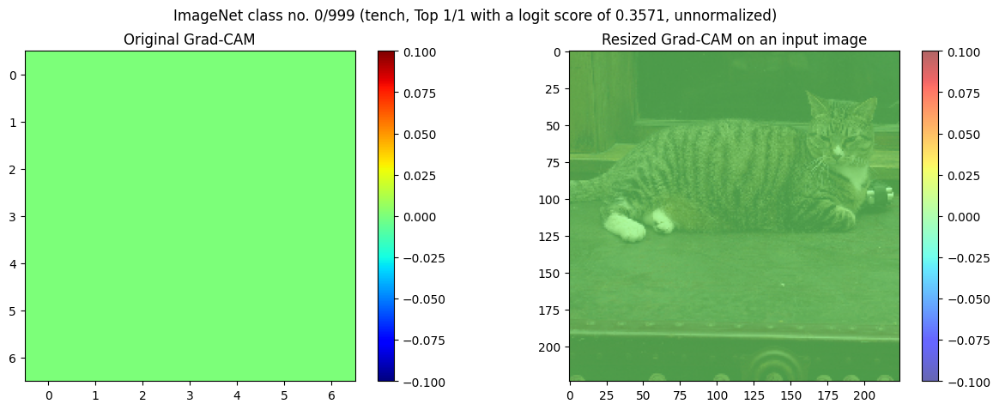

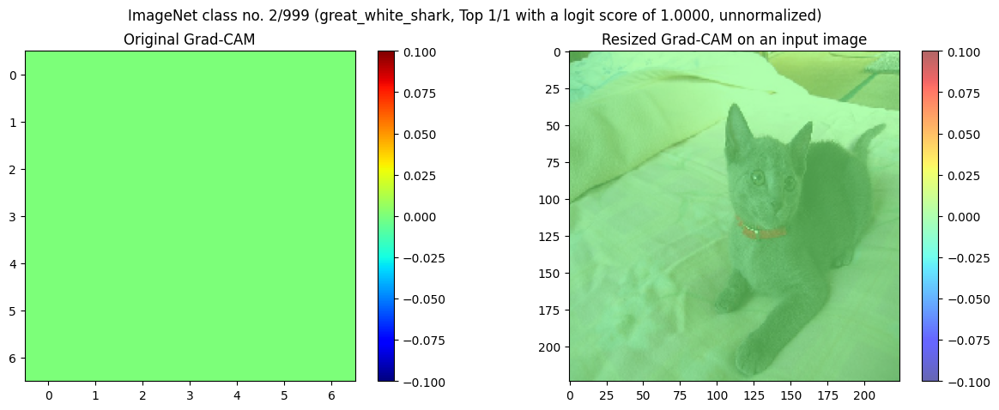

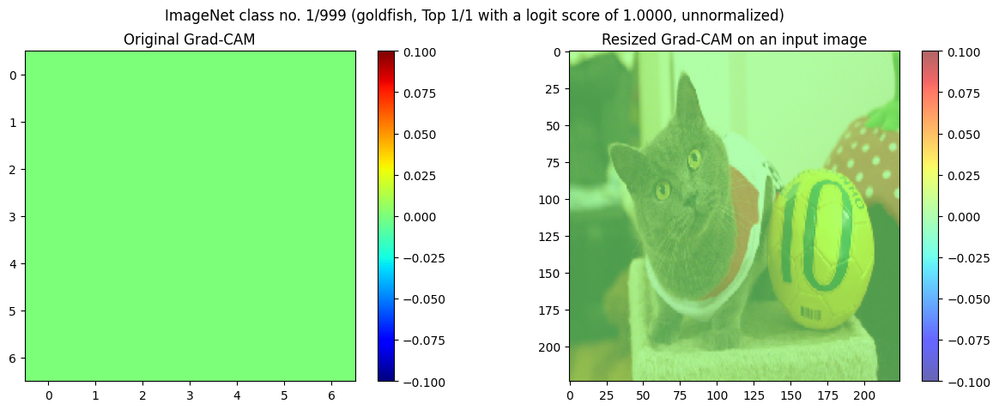

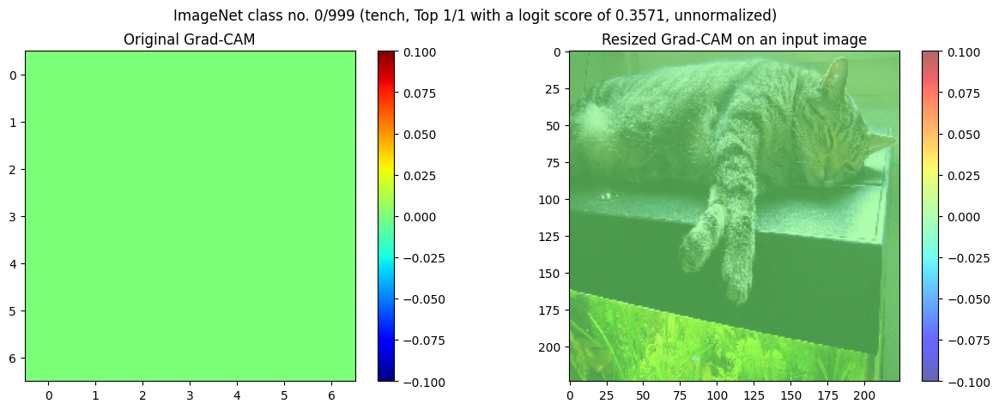

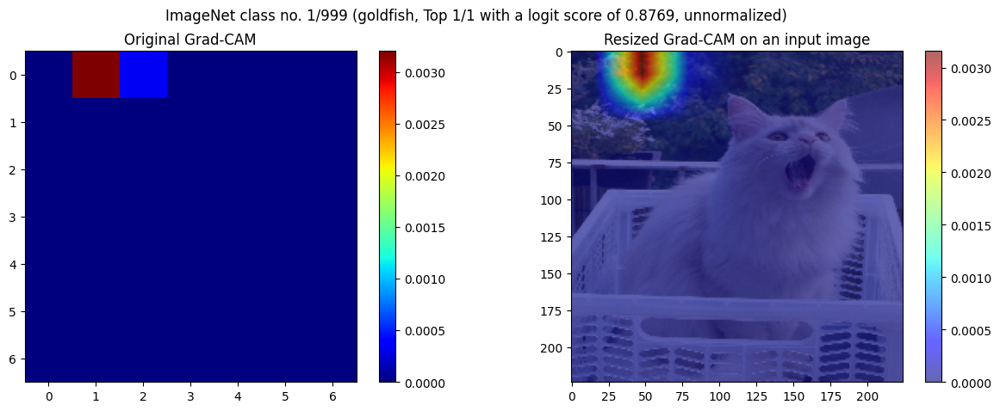

In [46]:
'''img_paths = vector_df['file_path']
img_paths = img_paths.iloc[0:20]

img_paths = [
              '/content/thai-cat-image-classification/Image/class1/class1-4.jpg',
              '/content/thai-cat-image-classification/Image/class1/class1-28.jpg',
              '/content/thai-cat-image-classification/Image/class1/class1-37.jpg',
              '/content/thai-cat-image-classification/Image/class2/class2-27.jpg',
              '/content/thai-cat-image-classification/Image/class2/class2-51.jpg',
              '/content/thai-cat-image-classification/Image/class2/class2-92.jpg',
              '/content/thai-cat-image-classification/Image/class2/class2-67.jpg',
              '/content/thai-cat-image-classification/Image/class3/class3-23.jpg',
              '/content/thai-cat-image-classification/Image/class3/class3-24.jpg',
              '/content/thai-cat-image-classification/Image/class3/class3-25.jpg',
            ]
imgs = []
imgs_preprocess = []
out_linears = []

for i in range(len(img_paths)):
  img = tf.keras.preprocessing.image.load_img(img_paths[i], target_size=(224, 224))
  img = tf.keras.preprocessing.image.img_to_array(img).astype(np.uint8)
  imgs.append(img)
  img_preprocess = tf.keras.applications.resnet50.preprocess_input( np.expand_dims(img, axis=0))
  imgs_preprocess.append(img_preprocess)
  out_linear = image_model.predict( img_preprocess )
  out_linears.append(out_linear)
  imagenet_dict, result = my_imagenet_decode_predictions( out_linear, top=3 )
  print(result)

for i in range(len(img_paths)):
  visualize_GradCAM_topresult(new_model, imgs[i], imgs_preprocess[i], out_linears[i], top=1, heatmap_norm=False)'''

IndexError: index 24 is out of bounds for axis 0 with size 24

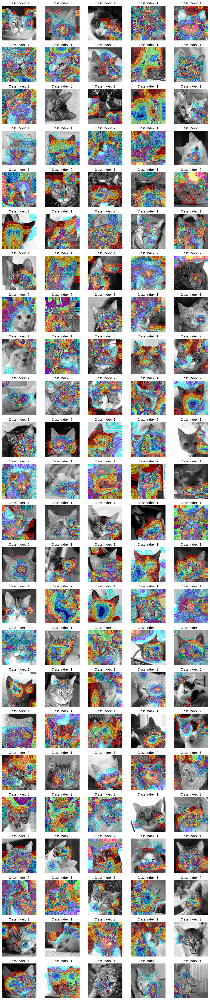

# Semi-Supervised

## FixMatch

In [202]:
import wandb

num_epochs = 600
learning_rate = 1e-3

# Initialize Wandb
run = wandb.init(
    # set the wandb project where this run will be logged
    project="Cat Facial Expression Recognition",

    # track hyperparameters and run metadata
    config={
    "learning_rate": learning_rate,
    "model": "FixMatch",
    "architecture": "MLP",
    "dataset": "CatFLW",
    "epochs": num_epochs,
    }
)

In [204]:
# Fixmatch

# num_classes = 3

import tensorflow as tf
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder

# Define a simple feedforward neural network for vector data
def build_model(input_shape, num_classes):
    model = tf.keras.Sequential([
        tf.keras.layers.Dense(128, activation='relu', input_shape=input_shape, kernel_regularizer=tf.keras.regularizers.l1_l2(l1=0.01, l2=0.01)),
        tf.keras.layers.Dropout(0.5),
        tf.keras.layers.Dense(128, activation='relu', kernel_regularizer=tf.keras.regularizers.l1_l2(l1=0.01, l2=0.01)),
        tf.keras.layers.Dropout(0.5),
        tf.keras.layers.Dense(128, activation='relu'),
        tf.keras.layers.Dense(num_classes, activation='softmax')
    ])
    return model

# Define loss functions
supervised_loss_fn = tf.keras.losses.CategoricalCrossentropy()
unsupervised_loss_fn = tf.keras.losses.MeanSquaredError()

# Define FixMatch training step
@tf.function
def train_step(model, optimizer, x_labeled, y_labeled, x_unlabeled, confidence_threshold=0.95):
    with tf.GradientTape() as tape:
        # Predictions for labeled data
        y_pred_labeled = model(x_labeled, training=True)
        sup_loss = supervised_loss_fn(y_labeled, y_pred_labeled)

        # Predictions for unlabeled data
        y_pred_unlabeled = model(x_unlabeled, training=True)
        pseudo_labels = tf.argmax(y_pred_unlabeled, axis=1)
        max_probs = tf.reduce_max(tf.nn.softmax(y_pred_unlabeled), axis=1)
        mask = max_probs >= confidence_threshold

        # Apply consistency regularization
        y_unlabeled = tf.stop_gradient(y_pred_unlabeled)
        cons_loss = unsupervised_loss_fn(y_unlabeled, y_pred_unlabeled)
        cons_loss = tf.reduce_mean(cons_loss * tf.cast(mask, tf.float32))

        # Total loss
        total_loss = sup_loss + cons_loss

    # Compute gradients and apply optimizer
    gradients = tape.gradient(total_loss, model.trainable_variables)
    optimizer.apply_gradients(zip(gradients, model.trainable_variables))
    return total_loss, sup_loss, cons_loss

# Evaluation function
def evaluate(model, x_test, y_test):
    y_pred = model.predict(x_test)
    accuracy = np.mean(np.argmax(y_pred, axis=1) == np.argmax(y_test, axis=1))
    return accuracy

# Data Feed
x_data = landmarks
y_data = integer_labels

# One-hot encode labels
encoder = OneHotEncoder(sparse=False)
y_data = encoder.fit_transform(y_data.reshape(-1, 1))

# Split data into labeled, unlabeled, and test sets
x_train_semi, x_test_semi, y_train_semi, y_test_semi = train_test_split(x_data, y_data, test_size=0.2, random_state=42)
x_labeled, x_unlabeled, y_labeled, y_unlabeled = train_test_split(x_train_semi, y_train_semi, test_size=0.5, random_state=42)

# Build and compile model
input_shape=(X_train_landmarks.shape[1],)
model = build_model(input_shape, num_classes)
optimizer = tf.keras.optimizers.Adam()

# Train model using FixMatch

batch_size = 32

for epoch in range(num_epochs):
    idx_labeled = np.random.choice(len(x_labeled), batch_size)
    idx_unlabeled = np.random.choice(len(x_unlabeled), batch_size)
    x_l_batch = x_labeled[idx_labeled]
    y_l_batch = y_labeled[idx_labeled]
    x_u_batch = x_unlabeled[idx_unlabeled]

    loss, sup_loss, cons_loss = train_step(model, optimizer, x_l_batch, y_l_batch, x_u_batch)

    if epoch % 10 == 0:
        accuracy_unlabeled = evaluate(model, x_unlabeled, y_unlabeled)
        accuracy_test = evaluate(model, x_test_semi, y_test_semi)
        print(f"Epoch {epoch}, Loss: {loss:.4f}, Unlabeled Accuracy: {accuracy_unlabeled:.4f}, Test Accuracy: {accuracy_test:.4f}")

        wandb.log({
          "epoch": epoch,
          "total_loss": loss.numpy(),
          "labeled_loss": sup_loss.numpy(),
          "unlabeled_loss": cons_loss.numpy(),
          "unlabelled_accuracy": accuracy_unlabeled,
          "val_acc": accuracy_test
        })

# Final evaluation
accuracy_unlabeled = evaluate(model, x_unlabeled, y_unlabeled)
accuracy_test = evaluate(model, x_test_semi, y_test_semi)
print(f"Final Unlabeled Accuracy: {accuracy_unlabeled:.4f}")
print(f"Final Test Accuracy: {accuracy_test:.4f}")

IndentationError: unindent does not match any outer indentation level (<tokenize>, line 94)

## Mean Teacher

In [105]:
import tensorflow as tf
import numpy as np
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense, Dropout
from tensorflow.keras.optimizers import Adam
from sklearn.model_selection import train_test_split
from tensorflow.keras.regularizers import l1_l2

def create_model(input_dim, output_dim):
    inputs = Input(shape=(input_dim,))
    x = Dense(128, activation='relu')(inputs)  # First dense layer
    x = Dropout(0.5)(x)  # Dropout layer
    x = Dense(128, activation='relu', kernel_regularizer=l1_l2(l1=0.01, l2=0.01))(x)  # Second dense layer with L1 and L2 regularization
    x = Dropout(0.5)(x)  # Dropout layer
    x = Dense(128, activation='relu')(x)  # Third dense layer
    outputs = Dense(output_dim, activation='softmax')(x)  # Output layer
    return Model(inputs, outputs)

def update_ema_variables(student_model, teacher_model, alpha):
    for student_var, teacher_var in zip(student_model.trainable_variables, teacher_model.trainable_variables):
        teacher_var.assign(teacher_var * alpha + student_var * (1 - alpha))

def compute_accuracy(model, dataset):
    accuracy = tf.keras.metrics.SparseCategoricalAccuracy()
    for inputs, targets in dataset:
        logits = model(inputs, training=False)
        accuracy.update_state(targets, logits)
    return accuracy.result().numpy()

def mean_teacher_train(student_model, teacher_model, labeled_dataset, unlabeled_dataset, test_dataset, num_classes, alpha=0.90, lambda_u=1.2, num_epochs=600, batch_size=32):
    optimizer = Adam()
    loss_fn = tf.keras.losses.SparseCategoricalCrossentropy()

    labeled_dataset = labeled_dataset.batch(batch_size)
    unlabeled_dataset = unlabeled_dataset.batch(batch_size)
    test_dataset = test_dataset.batch(batch_size)

    for epoch in range(num_epochs):
        for (inputs_l, targets_l), (inputs_u, targets_u) in zip(labeled_dataset, unlabeled_dataset):
            with tf.GradientTape() as tape:
                # Forward pass for labeled data
                logits_l = student_model(inputs_l, training=True)
                loss_l = loss_fn(targets_l, logits_l)

                # Forward pass for unlabeled data
                logits_u_student = student_model(inputs_u, training=True)
                logits_u_teacher = teacher_model(inputs_u, training=False)

                # Consistency loss
                loss_u = tf.reduce_mean(tf.square(logits_u_student - logits_u_teacher))

                # Total loss
                total_loss = loss_l + lambda_u * loss_u

            # Backward pass
            grads = tape.gradient(total_loss, student_model.trainable_variables)
            optimizer.apply_gradients(zip(grads, student_model.trainable_variables))

            # Update teacher model
            update_ema_variables(student_model, teacher_model, alpha)

            # Evaluate unlabelled accuracy with true labels
            unlabelled_accuracy = compute_accuracy(student_model, unlabeled_dataset)

            wandb.log({
                "epoch": epoch,
                "total_loss": total_loss.numpy(),
                "labeled_loss": loss_l.numpy(),
                "unlabeled_loss": loss_u.numpy(),
                "unlabelled_accuracy": unlabelled_accuracy,
                "val_acc": test_accuracy
            })

        if epoch % 10 == 0:
          # Evaluate test set accuracy
          test_accuracy = compute_accuracy(student_model, test_dataset)

          print(f"Epoch {epoch}/{num_epochs}, Loss: {total_loss.numpy():.4f}, Labeled Loss: {loss_l.numpy():.4f}, Unlabeled Loss: {loss_u.numpy():.4f}")
          print(f"Unlabelled Accuracy: {unlabelled_accuracy:.4f}, Test Set Accuracy: {test_accuracy:.4f}")

# Data Feed
x_data = landmarks
y_data = integer_labels

# Split data into labeled, unlabeled, and test sets
x_train_semi, x_test_semi, y_train_semi, y_test_semi = train_test_split(x_data, y_data, test_size=0.2, random_state=42)
x_labeled, x_unlabeled, y_labeled, y_unlabeled = train_test_split(x_train_semi, y_train_semi, test_size=0.5, random_state=42)

# Convert numpy arrays to TensorFlow datasets
labeled_dataset = tf.data.Dataset.from_tensor_slices((x_labeled, y_labeled))
unlabeled_dataset = tf.data.Dataset.from_tensor_slices((x_unlabeled, y_unlabeled))  # Use true labels for unlabeled data
test_dataset = tf.data.Dataset.from_tensor_slices((x_test_semi, y_test_semi))

# Example usage
input_dim = x_data.shape[1]  # Example input dimension
output_dim = num_classes  # Number of classes

student_model = create_model(input_dim, output_dim)
teacher_model = create_model(input_dim, output_dim)
teacher_model.set_weights(student_model.get_weights())  # Initialize teacher model weights

mean_teacher_train(student_model, teacher_model, labeled_dataset, unlabeled_dataset, test_dataset, output_dim)

Epoch 1/600, Loss: 1.1672, Labeled Loss: 1.1661, Unlabeled Loss: 0.0009
Unlabelled Accuracy: 0.5072, Test Set Accuracy: 0.4571
Epoch 11/600, Loss: 0.9568, Labeled Loss: 0.9533, Unlabeled Loss: 0.0029
Unlabelled Accuracy: 0.5362, Test Set Accuracy: 0.5143
Epoch 21/600, Loss: 0.8985, Labeled Loss: 0.8933, Unlabeled Loss: 0.0043
Unlabelled Accuracy: 0.5507, Test Set Accuracy: 0.5714
Epoch 31/600, Loss: 0.7441, Labeled Loss: 0.7417, Unlabeled Loss: 0.0020
Unlabelled Accuracy: 0.5797, Test Set Accuracy: 0.5714
Epoch 41/600, Loss: 0.5637, Labeled Loss: 0.5593, Unlabeled Loss: 0.0037
Unlabelled Accuracy: 0.5797, Test Set Accuracy: 0.5714
Epoch 51/600, Loss: 0.4347, Labeled Loss: 0.4227, Unlabeled Loss: 0.0099
Unlabelled Accuracy: 0.5942, Test Set Accuracy: 0.7143
Epoch 61/600, Loss: 0.3335, Labeled Loss: 0.3048, Unlabeled Loss: 0.0239
Unlabelled Accuracy: 0.7971, Test Set Accuracy: 0.8286
Epoch 71/600, Loss: 0.1491, Labeled Loss: 0.1307, Unlabeled Loss: 0.0154
Unlabelled Accuracy: 0.8551, Tes

## Label the CatFLW data

In [165]:
# Not run

import os
import json
import pandas as pd

# Define directories
image_dir = '/content/cat-facial-expression-recognition/CatFLW dataset/images/'
json_dir = '/content/cat-facial-expression-recognition/CatFLW dataset/labels/'

# Get list of image files
image_files = [f for f in os.listdir(image_dir) if os.path.isfile(os.path.join(image_dir, f))]

# Initialize list to store data
data = []

# Loop through each image file
for image_file in image_files:
    # Construct file paths
    image_path = os.path.join(image_dir, image_file)
    json_path = os.path.join(json_dir, image_file.replace('.png', '.json'))  # Assuming image files are .jpg

    # Read the JSON file
    if os.path.exists(json_path):
        with open(json_path, 'r') as f:
            json_data = json.load(f)

        # Extract coordinates and bounding box
        coordinates = json_data['labels']
        bounding_box = json_data['bounding_boxes']

        # Extract bounding box dimensions
        x_min, y_min, x_max, y_max = bounding_box
        box_width = x_max - x_min
        box_height = y_max - y_min

        # Normalize coordinates
        normalized_coords = []
        for (x, y) in coordinates:
            normalized_x = (x - x_min) / box_width
            normalized_y = (y - y_min) / box_height
            normalized_coords.append(normalized_x)
            normalized_coords.append(normalized_y)

        # Add data to the list
        data.append([image_file, image_path, bounding_box] + normalized_coords)

# Create DataFrame
column_names = ['image_file', 'file_path', 'bounding_box'] + [f'x{i//2+1}' if i % 2 == 0 else f'y{i//2+1}' for i in range(2 * len(coordinates))]
df_unlabelled = pd.DataFrame(data, columns=column_names)

In [166]:
df_unlabelled

,image_file,file_path,bounding_box,x1,y1,x2,y2,x3,y3,x4,...,x44,y44,x45,y45,x46,y46,x47,y47,x48,y48
0,00000036_005.png,/content/cat-facial-expression-recognition/Cat...,"[77.0, 115.0, 327.0, 388.0]",0.487620,0.694930,0.642624,0.538751,0.487812,0.722963,0.333056,...,0.603444,0.601590,0.465032,0.619315,0.515572,0.618095,0.306668,0.713227,0.661460,0.714513
1,00000060_008.png,/content/cat-facial-expression-recognition/Cat...,"[53.0, 0.0, 336.0, 300.0]",0.394364,0.859057,0.618883,0.586187,0.396173,0.878857,0.270576,...,0.556477,0.742277,0.358898,0.771943,0.424311,0.772483,0.233989,0.810337,0.610816,0.855660
2,00000307_029.png,/content/cat-facial-expression-recognition/Cat...,"[17.0, 0.0, 512.0, 505.0]",0.519612,0.859467,0.649075,0.475099,0.519309,0.884044,0.374745,...,0.599358,0.564756,0.484727,0.575154,0.534335,0.570543,0.379754,0.627646,0.651543,0.620675
3,CAT_01_00000136_019.png,/content/cat-facial-expression-recognition/Cat...,"[261.0, 65.0, 421.0, 232.0]",0.467244,0.855401,0.616250,0.629880,0.465850,0.879108,0.340162,...,0.575562,0.781060,0.450962,0.796802,0.501425,0.795976,0.312037,0.815988,0.611394,0.851090
4,00000404_003.png,/content/cat-facial-expression-recognition/Cat...,"[269.0, 346.0, 543.0, 555.0]",0.834562,0.483115,0.583891,0.351225,0.849887,0.482191,0.605901,...,0.753956,0.362048,0.788150,0.515053,0.779635,0.454244,0.828814,0.642172,0.792153,0.294909
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2074,00000444_009.png,/content/cat-facial-expression-recognition/Cat...,"[628.0, 93.0, 788.0, 247.0]",0.442287,0.759545,0.552813,0.616461,0.441569,0.787987,0.311481,...,0.541300,0.720526,0.434981,0.718175,0.481081,0.728377,0.288725,0.748994,0.565450,0.785734
2075,00000037_013.png,/content/cat-facial-expression-recognition/Cat...,"[286.0, 23.0, 421.0, 164.0]",0.515785,0.849007,0.641311,0.596057,0.516363,0.877319,0.350815,...,0.627081,0.751709,0.478215,0.789851,0.531400,0.785447,0.352652,0.821461,0.676496,0.799000
2076,00000072_018.png,/content/cat-facial-expression-recognition/Cat...,"[208.0, 90.0, 304.0, 184.0]",0.453188,0.788574,0.597594,0.564383,0.453563,0.819979,0.325219,...,0.570760,0.700968,0.413052,0.718085,0.480750,0.725000,0.300250,0.778883,0.635021,0.778309
2077,00000361_025.png,/content/cat-facial-expression-recognition/Cat...,"[37.0, 0.0, 432.0, 305.0]",0.376446,0.813538,0.537911,0.637003,0.373339,0.855033,0.292648,...,0.487866,0.746757,0.360218,0.749187,0.406276,0.764357,0.266514,0.758367,0.518147,0.803977


In [168]:
# Create landmark vectors

regions = {
    'left_eye': {'Center': [37, 38], 'Members': [4, 5, 6, 7, 8, 37, 38, 39]},
    'right_eye': {'Center': [40, 41], 'Members': [2, 9, 10, 11, 12, 40, 41, 42]},
    'forehead': {'Center': [23, 32], 'Members': [23, 24, 25, 26, 27, 28, 29, 30, 31, 32]},
    'mouth': {'Center': [17], 'Members': [1, 3, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 33, 34, 35, 36, 43, 44, 45, 46, 47, 48]}
}

# Function to calculate midpoint
def calculate_midpoint(coords, indices):
    x_coords = [coords[f'x{i}'] for i in indices]
    y_coords = [coords[f'y{i}'] for i in indices]
    midpoint_x = np.mean(x_coords)
    midpoint_y = np.mean(y_coords)
    return midpoint_x, midpoint_y

# Create vectors for each region
vector_data = []

for index, row in df_unlabelled.iterrows():
    image_file = row['image_file']
    file_path = row['file_path']
    bounding_box = row['bounding_box']
    coords = {f'x{i+1}': row[f'x{i+1}'] for i in range(len(coordinates))}
    coords.update({f'y{i+1}': row[f'y{i+1}'] for i in range(len(coordinates))})

    vector_row = [image_file, file_path, bounding_box]

    for region, points in regions.items():
        center_indices = points['Center']
        member_indices = points['Members']

        # Calculate midpoint for the center points
        midpoint_x, midpoint_y = calculate_midpoint(coords, center_indices)

        # Calculate vectors for each member point
        for i in member_indices:
            member_x = row[f'x{i}']
            member_y = row[f'y{i}']
            vector_x = member_x - midpoint_x
            vector_y = member_y - midpoint_y
            vector_row.extend([vector_x, vector_y])

    vector_data.append(vector_row)

# Create column names for the new DataFrame with vectors
vector_column_names = ['image_file', 'file_path','bounding_box'] + [f'{region}_point_{i+1}_x' for region in regions for i in regions[region]['Members']] + [f'{region}_point_{i+1}_y' for region in regions for i in regions[region]['Members']]

# Create the DataFrame with vectors
vector_df_unlabelled = pd.DataFrame(vector_data, columns=vector_column_names)

In [169]:
vector_df_unlabelled

,image_file,file_path,bounding_box,left_eye_point_5_x,left_eye_point_6_x,left_eye_point_7_x,left_eye_point_8_x,left_eye_point_9_x,left_eye_point_38_x,left_eye_point_39_x,...,mouth_point_34_y,mouth_point_35_y,mouth_point_36_y,mouth_point_37_y,mouth_point_44_y,mouth_point_45_y,mouth_point_46_y,mouth_point_47_y,mouth_point_48_y,mouth_point_49_y
0,00000036_005.png,/content/cat-facial-expression-recognition/Cat...,"[77.0, 115.0, 327.0, 388.0]",-0.004898,0.029368,-0.056618,-0.006797,0.059718,0.005786,-0.002018,...,0.116624,-0.049447,-0.021788,-0.031722,0.028752,-0.032941,-0.180152,0.062190,0.174640,0.063476
1,00000060_008.png,/content/cat-facial-expression-recognition/Cat...,"[53.0, 0.0, 336.0, 300.0]",-0.002546,0.032753,-0.058578,-0.044357,0.048500,0.055020,0.004521,...,0.163523,-0.074057,-0.034057,-0.044390,0.031357,-0.043850,-0.158965,-0.005997,0.217862,0.039327
2,00000307_029.png,/content/cat-facial-expression-recognition/Cat...,"[17.0, 0.0, 512.0, 505.0]",-0.003960,0.031224,-0.059796,-0.011339,0.054865,0.019661,-0.005214,...,0.088808,-0.049192,-0.025822,-0.038794,0.023786,-0.043406,-0.130796,0.013697,0.140994,0.006727
3,CAT_01_00000136_019.png,/content/cat-facial-expression-recognition/Cat...,"[261.0, 65.0, 421.0, 232.0]",-0.004697,0.020563,-0.063066,-0.017126,0.061984,0.025216,0.013034,...,0.108406,-0.058527,-0.016194,-0.042784,0.034269,-0.043611,-0.155119,-0.023599,0.144237,0.011503
4,00000404_003.png,/content/cat-facial-expression-recognition/Cat...,"[269.0, 346.0, 543.0, 555.0]",0.018473,0.000713,-0.005027,0.066789,0.008283,-0.072675,-0.044808,...,-0.061449,-0.121995,-0.027255,0.031010,-0.035770,-0.029799,0.013409,0.158129,-0.023252,-0.189134
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2074,00000444_009.png,/content/cat-facial-expression-recognition/Cat...,"[628.0, 93.0, 788.0, 247.0]",-0.005184,0.017938,-0.061578,-0.013360,0.047591,0.010406,0.016991,...,0.097956,-0.023571,-0.008362,-0.025922,0.037738,-0.015721,-0.154619,0.004896,0.122106,0.041636
2075,00000037_013.png,/content/cat-facial-expression-recognition/Cat...,"[286.0, 23.0, 421.0, 164.0]",0.003896,0.022046,-0.059704,-0.016358,0.071067,0.044011,0.003830,...,0.114630,-0.078688,-0.034237,-0.040546,0.018948,-0.044950,-0.159800,-0.008936,0.164044,-0.031397
2076,00000072_018.png,/content/cat-facial-expression-recognition/Cat...,"[208.0, 90.0, 304.0, 184.0]",-0.000036,0.023431,-0.066693,-0.017612,0.058151,0.031835,-0.003391,...,0.118271,-0.064894,-0.039438,-0.047777,0.028260,-0.040862,-0.152240,0.013021,0.182531,0.012447
2077,00000361_025.png,/content/cat-facial-expression-recognition/Cat...,"[37.0, 0.0, 432.0, 305.0]",-0.008990,0.026925,-0.035309,-0.033177,0.040352,0.028334,0.013684,...,0.110197,-0.042616,-0.017451,-0.040187,0.028608,-0.025016,-0.111154,-0.031007,0.140478,0.014603


In [187]:
import numpy as np
import pandas as pd
import tensorflow as tf
from sklearn.model_selection import train_test_split
from PIL import Image
import os

# Load landmarks and labels
landmarks_df_unlabelled = vector_df_unlabelled
#image_paths = landmarks_df['file_path'].values
landmarks_unlabelled = landmarks_df_unlabelled.drop(columns=['file_path','image_file','bounding_box']).values

pseudo_labels_full = np.argmax(model.predict(landmarks_unlabelled), axis=1)
pseudo_labels_full = np.array([int_to_label[integer] for integer in pseudo_labels_full])

# Add pseudo-labels to the filtered_df DataFrame
df_unlabelled['pseudo_label'] = pseudo_labels_full

65/65 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


In [193]:
filtered_image_files = filtered_df['image_file'].unique()
df_unlabelled = df_unlabelled[~df_unlabelled['image_file'].isin(filtered_image_files)]
df_unlabelled

,image_file,file_path,bounding_box,x1,y1,x2,y2,x3,y3,x4,...,y44,x45,y45,x46,y46,x47,y47,x48,y48,pseudo_label
0,00000036_005.png,/content/cat-facial-expression-recognition/Cat...,"[77.0, 115.0, 327.0, 388.0]",0.487620,0.694930,0.642624,0.538751,0.487812,0.722963,0.333056,...,0.601590,0.465032,0.619315,0.515572,0.618095,0.306668,0.713227,0.661460,0.714513,Attentive
1,00000060_008.png,/content/cat-facial-expression-recognition/Cat...,"[53.0, 0.0, 336.0, 300.0]",0.394364,0.859057,0.618883,0.586187,0.396173,0.878857,0.270576,...,0.742277,0.358898,0.771943,0.424311,0.772483,0.233989,0.810337,0.610816,0.855660,Terrified
3,CAT_01_00000136_019.png,/content/cat-facial-expression-recognition/Cat...,"[261.0, 65.0, 421.0, 232.0]",0.467244,0.855401,0.616250,0.629880,0.465850,0.879108,0.340162,...,0.781060,0.450962,0.796802,0.501425,0.795976,0.312037,0.815988,0.611394,0.851090,Attentive
4,00000404_003.png,/content/cat-facial-expression-recognition/Cat...,"[269.0, 346.0, 543.0, 555.0]",0.834562,0.483115,0.583891,0.351225,0.849887,0.482191,0.605901,...,0.362048,0.788150,0.515053,0.779635,0.454244,0.828814,0.642172,0.792153,0.294909,Attentive
5,00000367_025.png,/content/cat-facial-expression-recognition/Cat...,"[389.0, 408.0, 689.0, 703.0]",0.848053,0.302922,0.577680,0.299827,0.889027,0.284963,0.704483,...,0.239336,0.805600,0.352125,0.778640,0.302553,0.889220,0.471634,0.780033,0.192244,Attentive
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2074,00000444_009.png,/content/cat-facial-expression-recognition/Cat...,"[628.0, 93.0, 788.0, 247.0]",0.442287,0.759545,0.552813,0.616461,0.441569,0.787987,0.311481,...,0.720526,0.434981,0.718175,0.481081,0.728377,0.288725,0.748994,0.565450,0.785734,Attentive
2075,00000037_013.png,/content/cat-facial-expression-recognition/Cat...,"[286.0, 23.0, 421.0, 164.0]",0.515785,0.849007,0.641311,0.596057,0.516363,0.877319,0.350815,...,0.751709,0.478215,0.789851,0.531400,0.785447,0.352652,0.821461,0.676496,0.799000,Relaxed
2076,00000072_018.png,/content/cat-facial-expression-recognition/Cat...,"[208.0, 90.0, 304.0, 184.0]",0.453188,0.788574,0.597594,0.564383,0.453563,0.819979,0.325219,...,0.700968,0.413052,0.718085,0.480750,0.725000,0.300250,0.778883,0.635021,0.778309,Attentive
2077,00000361_025.png,/content/cat-facial-expression-recognition/Cat...,"[37.0, 0.0, 432.0, 305.0]",0.376446,0.813538,0.537911,0.637003,0.373339,0.855033,0.292648,...,0.746757,0.360218,0.749187,0.406276,0.764357,0.266514,0.758367,0.518147,0.803977,Terrified
